# Starbucks Challenge
## Capstone Project
### [Machine Learning Engineer Nanodegree Program – Udacity](https://www.udacity.com/course/machine-learning-engineer-nanodegree--nd009t)
Starbucks is the largest coffeehouse chain company in the world. It operates in 78 countries with over 30,000 locations [[Starbucks – Wikipedia](https://en.wikipedia.org/wiki/Starbucks)]. Because Starbucks serves coffee to people with different backgrounds, cultures, mentality, it has to provide customized advertisements to different demographic groups to boost their sales.

For promoting its products, Starbucks uses many channels, including a special rewards mobile app. In this challenge, Starbucks asks us to develop an algorithm that will help them to optimize advertisements through their mobile app. Thus, the goal of this challenge is to identify existing in the dataset demographic groups and propose the most suitable offers for them to boost sales.

## 1. Input Data Explanation
Luckily, Starbucks has provided us with the dataset. Due to the purpose of privacy and safety, the dataset is artificially generated rather than containing real customers’ data. With this artificially generated data, Starbucks tried to simulate their mobile app users’ behavior and the influence made on them by different types of offers.

The dataset consists of 3 files: *portfolio.json, profile.json, transcript.json. portfolio.json* describes what offers Starbucks has sent to its customers. In general, there are 3 types of offers: buy-one-get-one (BOGO), discount, and informational; each of which contains subtypes that are distinguished by several parameters. Namely: *reward* – an amount of money a customer receives after completing conditions of an offer (0 in case of an informational offer), *channels* – the medium used to deliver an offer, *difficulty* – an amount a customer needs to spend to get the reward, *duration* – an offer duration (or influence) period, *offer_type* – an offer type, and *id* – is an offer id number. An example of *portfolio.json*:
<img src="img/portfolio.png">

Next, *profile.json* contains Starbucks’ customers information, such as id number, gender, age, income, and date of joining the membership program. Unlike in the previous file, some rows in this file have missing values, namely in gender, income and age columns (118 in the age column means that the real value is absent). An example of *profile.json*:
<img src="img/profile.png">

Lastly, *transcript.json* contains transactions/events information happened throughout the month, such as: when customers received, viewed, completed offers and all spendings made by them. Particularly, there are 4 columns: *person* – a customer’s id, *event* –  could be one of 4 possible values: offer received, offer viewed, offer completed and transaction, *value* – contains an offer id (and reward if any) associated with the event or a transaction amount, *time* – time of the event occurrence in hours (starts at 0).
<img src="img/transcript.png">

There is one important detail to remember – a customer may complete an offer without even knowing it (if the customer received an offer and never viewed it but completed the conditions). In this case, it is important to understand that the purchase decision was made not under the offer's influence.

## 2. Data Preprocessing and Cleaning
In this step, data provided by Starbucks is preprocessed (by cleaning rows with missed information) and converted into one table:

| id | gender | age | income | difficulty | reward | web | mobile | social | bogo | disc | info | amount_spend |
|----|--------|-----|--------|------------|--------|-----|--------|--------|------|------|------|--------------|

This is necessary for convinient data exploration, visualization and further use in algorithms. Fields *id, gender, age*, and *income* are copied from *profile.json*; *difficulty, reward, web, mobile, social* are from *portfolio.json*; and *bogo, disc, info* and *amount_spend* are calculated from *transcript.json*. Values in bogo, disc, info are calculated by matching customers' responses to each offer, particularly:

0 – the offer was not given to a customer.  
1 – a customer received the offer but never viewed it.  
2 – the offer was viewed.  
3 – the offer was viewed and completed (in the case of informational offers, it means that the offer was viewed and a transaction was made by the customer within the “influence” period specified by Starbucks).

The output table is saved in 2 forms: *data* and *data_brief*. The former one for use in algorithms and the latter for visualization purposes.

In [44]:
%%time
import pandas as pd

from preprocess import preprocess


portfolio = pd.read_json('./data/portfolio.json', orient='records', lines=True)
profile = pd.read_json('./data/profile.json', orient='records', lines=True)
transcript = pd.read_json('./data/transcript.json', orient='records', lines=True)

preprocess(portfolio, profile, transcript)

Processed 1000 entries
Processed 2000 entries
Processed 3000 entries
Processed 4000 entries
Processed 5000 entries
Processed 6000 entries
Processed 7000 entries
Processed 8000 entries
Processed 9000 entries
Processed 10000 entries
Processed 11000 entries
Processed 12000 entries
Processed 13000 entries
Processed 14000 entries
Saving data.pkl
Saving data_brief.pkl
Preprocessing done in 00:14:54


## 3. Data Exploration and Visualization

Now that we processed and cleaned data, we can visualize it for better understanding. First, let's load preprocessed data.

In [83]:
data = pd.read_pickle('data/data_brief.pkl')

Starting with simple visualization, let's see data distribution for age, gender, annual income and monthly spendings at Starbucks.

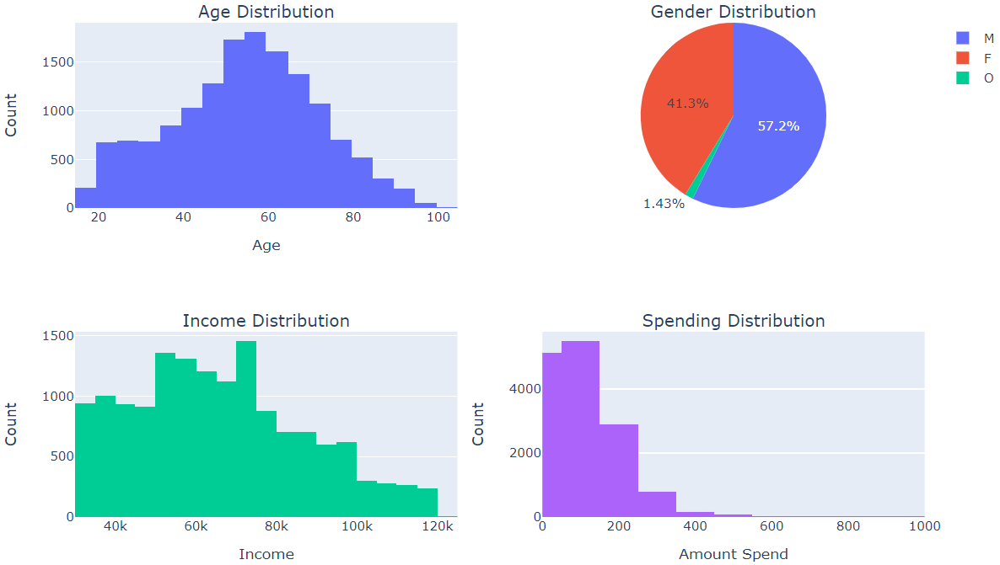

In [98]:
import os

from IPython.display import Image, display
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from visualization import update_axes


img = './img/distributions.png'
if os.path.isfile(img):
    display(Image(filename=img))
else:
    fig = make_subplots(rows=2, cols=2,
                        subplot_titles=("Age Distribution","Gender Distribution",
                                        "Income Distribution", "Spending Distribution"),
                        specs=[[{"type": "histogram"}, {"type": "pie"}],
                               [{"type": "histogram"}, {"type": "histogram"}]])

    fig.add_trace(go.Histogram(x=data['age'], nbinsx=30, name='Age', showlegend=False), row=1, col=1)
    fig.add_trace(go.Pie(labels=data['gender'], name='Gender'), row=1, col=2)
    fig.add_trace(go.Histogram(x=data['income'], nbinsx=30, name='Income', showlegend=False), row=2, col=1)
    fig.add_trace(go.Histogram(x=data['amount_spend'], nbinsx=30, name='Amount Spend', showlegend=False), row=2, col=2)

    update_axes(fig, [{'xtitle': 'Age', 'ytitle': 'Count', 'range': None, 'row': 1, 'col': 1},
                      {'xtitle': 'Income', 'ytitle': 'Count', 'range': None, 'row': 2, 'col': 1},
                      {'xtitle': 'Amount Spend', 'ytitle': 'Count', 'range': [0, 1000], 'row': 2, 'col': 2}])

    fig.update_layout(height=650)
    fig.show(renderer='notebook')

Most clients of Starbucks are between 50 and 64 years old, have an annual income of 50k to 74k and spend below $150 per month at Starbucks. The majority of the customers are male, followed by female and then by non-binary genders. Because the number of non-binary gender customers is small, it is important to capture their behavior by including them in both training and test sets.

Moving on with vusialization, let's see how age and annual income affect customers' spending behavior.

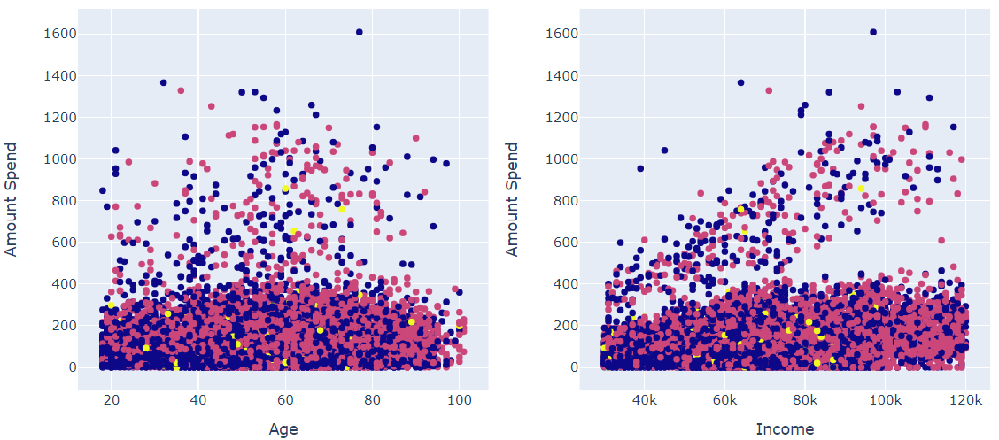

In [99]:
img = './img/scatter_plots.png'
if os.path.isfile(img):
    display(Image(filename=img))
else:
    fig = make_subplots(rows=1, cols=2)

    colors = data['gender'].replace(['M', 'F', 'O'], [1, 2, 3])
    fig.add_trace(go.Scatter(x=data['age'], y=data['amount_spend'],
                             mode='markers', marker_color=colors, text=data['gender'], showlegend=False), row=1, col=1)
    fig.add_trace(go.Scatter(x=data['income'], y=data['amount_spend'],
                             mode='markers', marker_color=colors, text=data['gender'], showlegend=False), row=1, col=2)

    update_axes(fig, [{'xtitle': 'Age', 'ytitle': 'Amount Spend', 'range': None, 'row': 1, 'col': 1},
                      {'xtitle': 'Income', 'ytitle': 'Amount Spend', 'range': None, 'row': 1, 'col': 2}])

    fig.show(renderer='notebook')

Two explicit clusters can be observed, one at the bottom of both plots and the other one located above the first one.

Now, let's see how customers' of different age, income and gender respond on different types of offers. The graphs below show the percentage of positive responses (when the offer was viewed and completed by a customer) given by customers in comparison with the total number of offers distributed. The graphs share horizontal axes for convince. 

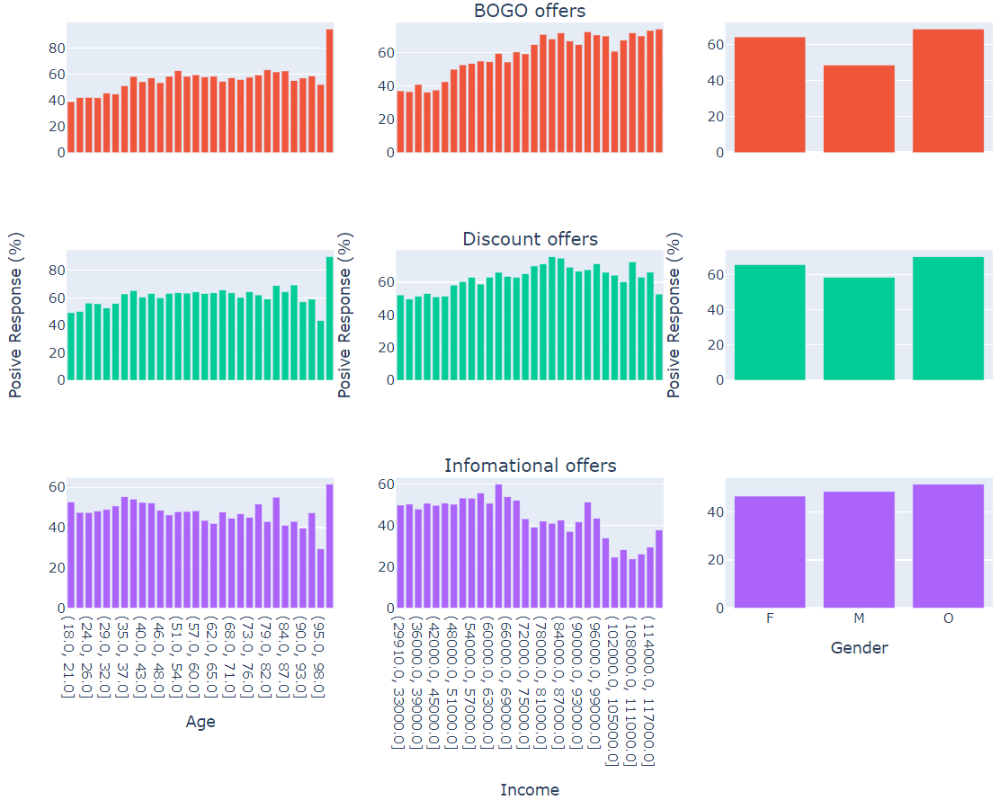

In [100]:
import plotly.express as px

from visualization import count_positives


n_bins = 30

img = './img/responses.png'
if os.path.isfile(img):
    display(Image(filename=img))
else:
    graph_data = {}
    for offer in ['bogo', 'disc', 'info']:
        graph_data.update({offer: {}})
        for feature in ['age', 'income', 'gender']:
            graph_data[offer][feature] = count_positives(data, feature, offer, n_bins)

    fig = make_subplots(rows=3, cols=3, shared_xaxes=True,
                        subplot_titles=('', 'BOGO offers', '', '', 'Discount offers', '', '', 'Infomational offers', ''))

    colors = px.colors.qualitative.Plotly
    row = 1
    for offer in ['bogo', 'disc', 'info']:
        fig.add_trace(go.Bar(x=graph_data[offer]['age'].index.astype(str).to_list(),
                             y=graph_data[offer]['age'][offer].to_list(), marker_color=colors[row], name='Age',
                             showlegend=False), row=row, col=1)
        fig.add_trace(go.Bar(x=graph_data[offer]['income'].index.astype(str).to_list(),
                             y=graph_data[offer]['income'][offer].to_list(), marker_color=colors[row], name='Income',
                             showlegend=False), row=row, col=2)
        fig.add_trace(go.Bar(x=graph_data[offer]['gender'].index.astype(str).to_list(),
                             y=graph_data[offer]['gender'][offer].to_list(), marker_color=colors[row], name='Gender',
                             showlegend=False), row=row, col=3)
        row += 1

    update_axes(fig, [{'xtitle': '', 'ytitle': 'Posive Response (%)', 'range': None, 'row': 2, 'col': 1},
                      {'xtitle': '', 'ytitle': 'Posive Response (%)', 'range': None, 'row': 2, 'col': 2},
                      {'xtitle': '', 'ytitle': 'Posive Response (%)', 'range': None, 'row': 2, 'col': 3},
                      {'xtitle': 'Age', 'ytitle': '', 'range': None, 'row': 3, 'col': 1},
                      {'xtitle': 'Income', 'ytitle': '', 'range': None, 'row': 3, 'col': 2},
                      {'xtitle': 'Gender', 'ytitle': '', 'range': None, 'row': 3, 'col': 3}])

    fig.update_layout(height=800)
    fig.show(renderer='notebook')

BOGO offers: from the graphs it can be seen that the percentage of positive responses given to the offers increases with the growth of age and income. Also, females give positive responses more often than males.

Discount offers: the graphs look very similar to the BOGO offers graphs. However, we can see that customers in general like discount offers the most. The discount offers have the highest average positive response rate among all the offers. If we have no data available about a customer for demographic grouping, it will be safe to give a discount offer to the customer.

Informational offers: unlike the previous two type of offers, this type's positive response rate decreases over customers' age and income. Additionally, informational offers have the lowest average positive response rate among all the offers.

## 4. Splitting the Data into Training and Test Sets and Uploading to S3

Before training machine learning models, we need to split the data into training, validation and test sets (in proportions 64%:16%:20% respectively)

In [2]:
from preprocess import split_data


data = pd.read_pickle('data/data.pkl')
offers = ['bogo', 'disc', 'info']
data = split_data(data, offers, stratify=offers, scaling=['age', 'income'])

Number of data points in train: 35344, validation: 8880, test: 10998


There is a separate dataset generated for each label for convenience. Because not all customers receive all the offers, there are some rows in `y` that have labels 0 (that is no offer received). Since customers did not receive an offer and did not respond to it, such rows were deleted from training, validation and test sets during the splitting data stage.

The goal of this challenge is to identify the best offer for a customer. So, label 3 will be considered as a positive response to an offer and 1 is negative (see [2. Data Preprocessing and Cleaning](#2.-Data-Preprocessing-and-Cleaning) for more information about labels). Unlike these labels, label 2 can be interpreted differently, one way is that a customer saw the offer but did not completed it due to some circumstances and the other one is that the customer was not interested enough in the offer. Anyway, no matter how we interpret the label, we would like to be sure that if a customer receives an offer, he or she will eventually complete it. Thus, we can consider label 2 as a negative response.

So, let's remap current labels into poisitve (1) and negative (0) labels.

In [3]:
for offer in data.values():
    for dataset in offer.values():
        dataset['y'] = dataset['y'].replace([1, 2, 3], [0, 0, 1])

Now we need to upload datasets to S3 to feed into SageMaker's algorithms. First, import necessary S3 libraries:

In [4]:
import boto3
import sagemaker
from sagemaker import get_execution_role
from sagemaker.amazon.amazon_estimator import get_image_uri


# sagemaker session, role
session = sagemaker.Session()
role = sagemaker.get_execution_role()

# S3 bucket name
bucket = session.default_bucket()

And then upload datasets to S3:

In [5]:
bucket_prefix = 'starbucks-challenge-data'
data_dir = './data/csv'
if not os.path.exists(data_dir):
    os.makedirs(data_dir)

s3_input_train = {}
s3_input_valid = {}
train_location = {}
valid_location = {}
test_location = {}
for offer in offers:
    pd.concat([data[offer]['train']['y'], data[offer]['train']['X']], axis=1).\
        to_csv(os.path.join(data_dir, offer + '_train.csv'), header=False, index=False)
    pd.concat([data[offer]['valid']['y'], data[offer]['valid']['X']], axis=1).\
        to_csv(os.path.join(data_dir, offer + '_valid.csv'), header=False, index=False)
    data[offer]['valid']['X'].to_csv(os.path.join(data_dir, offer + '_test.csv'), header=False, index=False)
    
    train_location[offer] = session.upload_data(os.path.join(data_dir, offer + '_train.csv'), key_prefix=bucket_prefix)
    valid_location[offer] = session.upload_data(os.path.join(data_dir, offer + '_valid.csv'), key_prefix=bucket_prefix)
    test_location[offer] = session.upload_data(os.path.join(data_dir, offer + '_test.csv'), key_prefix=bucket_prefix)

    # This is a wrapper around the location of our train and validation data, to make sure that SageMaker
    # knows our data is in csv format.
    s3_input_train[offer] = sagemaker.s3_input(s3_data=train_location[offer], content_type='text/csv; label_size=1')
    s3_input_valid[offer] = sagemaker.s3_input(s3_data=valid_location[offer], content_type='text/csv; label_size=1')

## 5. Metrics
In this project, we would like to identify customers that will likely respond positively to offers to increase sales and product awareness (in the case of informational offers). Because this is a classification problem, metrics suitable for classification tasks should be used. The majority of them are related to or based on precision and recall, e.g. accuracy, AUC, F1 score, etc. Algorithms with higher precision have fewer false positive errors (negative labels mistakenly predicted as positives) and algorithms with higher recall have fewer false negative errors (positive labels predicted as negative). Most algorithms try to find a balance between precision and recall. However, in the Starbucks case, recall is more important than precision. The reason for that is we would rather send more offers to customers who responded negatively previously (false positive) than not sending offers to customers who have given positive responses (false negative).

To capture such importance of recall, [F-score](https://en.wikipedia.org/wiki/F1_score) metric will be used to measure the performance of models throughout this project. In this project it is assumed that recall is by 20% more important than precision, thus β is set to 1.2.

In [6]:
beta = 1.2

## 6. Building a Benchmark Model

As the benchmark model, I will use a simple yet powerful and therefore popular method – linear classification provided by Amazon, namely Linear Learner.

#### Linear model initialization
First, we need to initialize the Linear Learner model. There is a separate model for each offer type.

In [39]:
# specify an output path
model_prefix = 'starbucks-challenge-models'
output_path = 's3://{}/{}'.format(bucket, model_prefix)

# construct the image name for the Linear Learner training container.
container = get_image_uri(session.boto_region_name, 'linear-learner')

# instantiate LinearLearner
linear_models = {}
for offer in offers:
    linear_models[offer] = sagemaker.estimator.Estimator(container,
                                                         role=role,
                                                         train_instance_count=1,
                                                         train_instance_type='ml.c4.xlarge',
                                                         output_path=output_path,
                                                         sagemaker_session=session)
    
    linear_models[offer].set_hyperparameters(predictor_type='binary_classifier',
                                             epochs=1000,
                                             early_stopping_patience=5)

#### Train the linear model
Train models for each offer one by one.

In [ ]:
%%time

for offer in offers:
    linear_models[offer].fit({'train': s3_input_train[offer], 'validation': s3_input_valid[offer]})

2020-02-03 13:03:18 Starting - Starting the training job...
2020-02-03 13:03:20 Starting - Launching requested ML instances......
2020-02-03 13:04:24 Starting - Preparing the instances for training......
2020-02-03 13:05:38 Downloading - Downloading input data...
2020-02-03 13:06:11 Training - Training image download completed. Training in progress..Docker entrypoint called with argument(s): train
[02/03/2020 13:06:14 INFO 140180748695360] Reading default configuration from /opt/amazon/lib/python2.7/site-packages/algorithm/resources/default-input.json: {u'loss_insensitivity': u'0.01', u'epochs': u'15', u'feature_dim': u'auto', u'init_bias': u'0.0', u'lr_scheduler_factor': u'auto', u'num_calibration_samples': u'10000000', u'accuracy_top_k': u'3', u'_num_kv_servers': u'auto', u'use_bias': u'true', u'num_point_for_scaler': u'10000', u'_log_level': u'info', u'quantile': u'0.5', u'bias_lr_mult': u'auto', u'lr_scheduler_step': u'auto', u'init_method': u'uniform', u'init_sigma': u'0.01', u'lr

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6495454668317522, "sum": 0.6495454668317522, "min": 0.6495454668317522}}, "EndTime": 1580735188.704769, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 16}, "StartTime": 1580735188.704714}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6495331115722657, "sum": 0.6495331115722657, "min": 0.6495331115722657}}, "EndTime": 1580735188.704839, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 16}, "StartTime": 1580735188.704827}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6493467102050782, "sum": 0.6493467102050782, "min": 0.6493467102050782}}, "EndTime": 1580735188.704895, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lear

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6494016723632813, "sum": 0.6494016723632813, "min": 0.6494016723632813}}, "EndTime": 1580735193.605859, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 22}, "StartTime": 1580735193.605801}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6493938031877791, "sum": 0.6493938031877791, "min": 0.6493938031877791}}, "EndTime": 1580735193.605928, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 22}, "StartTime": 1580735193.605916}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6492457929338727, "sum": 0.6492457929338727, "min": 0.6492457929338727}}, "EndTime": 1580735193.605969, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lear

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6560349551406163, "sum": 0.6560349551406163, "min": 0.6560349551406163}}, "EndTime": 1580735203.96919, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 34}, "StartTime": 1580735203.96912}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6560734125994377, "sum": 0.6560734125994377, "min": 0.6560734125994377}}, "EndTime": 1580735203.969266, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 34}, "StartTime": 1580735203.969252}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6560663806231143, "sum": 0.6560663806231143, "min": 0.6560663806231143}}, "EndTime": 1580735203.96932, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": 

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6560832453751009, "sum": 0.6560832453751009, "min": 0.6560832453751009}}, "EndTime": 1580735218.901749, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 52}, "StartTime": 1580735218.901675}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6561686483421186, "sum": 0.6561686483421186, "min": 0.6561686483421186}}, "EndTime": 1580735218.901824, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 52}, "StartTime": 1580735218.901811}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6561187392970066, "sum": 0.6561187392970066, "min": 0.6561187392970066}}, "EndTime": 1580735218.901872, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.64894921875, "sum": 0.64894921875, "min": 0.64894921875}}, "EndTime": 1580735229.244456, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 65}, "StartTime": 1580735229.2444}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6489536525181362, "sum": 0.6489536525181362, "min": 0.6489536525181362}}, "EndTime": 1580735229.244533, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 65}, "StartTime": 1580735229.244516}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6489060320172991, "sum": 0.6489060320172991, "min": 0.6489060320172991}}, "EndTime": 1580735229.244592, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 65

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6561391928408075, "sum": 0.6561391928408075, "min": 0.6561391928408075}}, "EndTime": 1580735238.877512, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 76}, "StartTime": 1580735238.877439}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562857166154311, "sum": 0.6562857166154311, "min": 0.6562857166154311}}, "EndTime": 1580735238.877589, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 76}, "StartTime": 1580735238.877575}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6561730936474924, "sum": 0.6561730936474924, "min": 0.6561730936474924}}, "EndTime": 1580735238.877633, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488693716866629, "sum": 0.6488693716866629, "min": 0.6488693716866629}}, "EndTime": 1580735249.277438, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 89}, "StartTime": 1580735249.27738}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6489006914411273, "sum": 0.6489006914411273, "min": 0.6489006914411273}}, "EndTime": 1580735249.277517, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 89}, "StartTime": 1580735249.2775}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488416966029575, "sum": 0.6488416966029575, "min": 0.6488416966029575}}, "EndTime": 1580735249.277577, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488445390973773, "sum": 0.6488445390973773, "min": 0.6488445390973773}}, "EndTime": 1580735259.122621, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 101}, "StartTime": 1580735259.122566}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488868800571986, "sum": 0.6488868800571986, "min": 0.6488868800571986}}, "EndTime": 1580735259.122691, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 101}, "StartTime": 1580735259.122679}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488212411063058, "sum": 0.6488212411063058, "min": 0.6488212411063058}}, "EndTime": 1580735259.122749, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488257533482142, "sum": 0.6488257533482142, "min": 0.6488257533482142}}, "EndTime": 1580735269.141479, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 113}, "StartTime": 1580735269.141422}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488793727329799, "sum": 0.6488793727329799, "min": 0.6488793727329799}}, "EndTime": 1580735269.141548, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 113}, "StartTime": 1580735269.141536}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488055812290736, "sum": 0.6488055812290736, "min": 0.6488055812290736}}, "EndTime": 1580735269.141603, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562077910117878, "sum": 0.6562077910117878, "min": 0.6562077910117878}}, "EndTime": 1580735279.431496, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 125}, "StartTime": 1580735279.431428}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564173713146619, "sum": 0.6564173713146619, "min": 0.6564173713146619}}, "EndTime": 1580735279.431579, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 125}, "StartTime": 1580735279.431561}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562366041279294, "sum": 0.6562366041279294, "min": 0.6562366041279294}}, "EndTime": 1580735279.43164, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562177180039425, "sum": 0.6562177180039425, "min": 0.6562177180039425}}, "EndTime": 1580735289.280085, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 137}, "StartTime": 1580735289.280014}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564335679860721, "sum": 0.6564335679860721, "min": 0.6564335679860721}}, "EndTime": 1580735289.280161, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 137}, "StartTime": 1580735289.280148}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562456146505754, "sum": 0.6562456146505754, "min": 0.6562456146505754}}, "EndTime": 1580735289.280197, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487898472377233, "sum": 0.6487898472377233, "min": 0.6487898472377233}}, "EndTime": 1580735299.518381, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 150}, "StartTime": 1580735299.518324}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488617510114397, "sum": 0.6488617510114397, "min": 0.6488617510114397}}, "EndTime": 1580735299.518451, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 150}, "StartTime": 1580735299.518439}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648775146484375, "sum": 0.648775146484375, "min": 0.648775146484375}}, "EndTime": 1580735299.518517, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656233143813149, "sum": 0.656233143813149, "min": 0.656233143813149}}, "EndTime": 1580735309.599492, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 162}, "StartTime": 1580735309.59942}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564558459037547, "sum": 0.6564558459037547, "min": 0.6564558459037547}}, "EndTime": 1580735309.599568, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 162}, "StartTime": 1580735309.599555}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562595501261884, "sum": 0.6562595501261884, "min": 0.6562595501261884}}, "EndTime": 1580735309.599622, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm":

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562386169347942, "sum": 0.6562386169347942, "min": 0.6562386169347942}}, "EndTime": 1580735319.595963, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 174}, "StartTime": 1580735319.595893}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564626037957392, "sum": 0.6564626037957392, "min": 0.6564626037957392}}, "EndTime": 1580735319.596047, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 174}, "StartTime": 1580735319.596028}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562644922094267, "sum": 0.6562644922094267, "min": 0.6562644922094267}}, "EndTime": 1580735319.596108, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562431650217951, "sum": 0.6562431650217951, "min": 0.6562431650217951}}, "EndTime": 1580735329.425435, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 186}, "StartTime": 1580735329.425361}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564675458789775, "sum": 0.6564675458789775, "min": 0.6564675458789775}}, "EndTime": 1580735329.425513, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 186}, "StartTime": 1580735329.425499}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562686206047835, "sum": 0.6562686206047835, "min": 0.6562686206047835}}, "EndTime": 1580735329.425578, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487675301688058, "sum": 0.6487675301688058, "min": 0.6487675301688058}}, "EndTime": 1580735339.677236, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 199}, "StartTime": 1580735339.677178}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488499755859375, "sum": 0.6488499755859375, "min": 0.6488499755859375}}, "EndTime": 1580735339.677324, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 199}, "StartTime": 1580735339.677303}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487558550153459, "sum": 0.6487558550153459, "min": 0.6487558550153459}}, "EndTime": 1580735339.677387, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562504111265086, "sum": 0.6562504111265086, "min": 0.6562504111265086}}, "EndTime": 1580735349.844729, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 211}, "StartTime": 1580735349.844658}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564748005488265, "sum": 0.6564748005488265, "min": 0.6564748005488265}}, "EndTime": 1580735349.844815, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 211}, "StartTime": 1580735349.844796}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562751129775646, "sum": 0.6562751129775646, "min": 0.6562751129775646}}, "EndTime": 1580735349.844878, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562530834488142, "sum": 0.6562530834488142, "min": 0.6562530834488142}}, "EndTime": 1580735359.848938, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 223}, "StartTime": 1580735359.848862}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564767533997421, "sum": 0.6564767533997421, "min": 0.6564767533997421}}, "EndTime": 1580735359.849029, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 223}, "StartTime": 1580735359.849008}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562774769549887, "sum": 0.6562774769549887, "min": 0.6562774769549887}}, "EndTime": 1580735359.849102, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487591770717076, "sum": 0.6487591770717076, "min": 0.6487591770717076}}, "EndTime": 1580735369.978795, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 236}, "StartTime": 1580735369.978739}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488399919782366, "sum": 0.6488399919782366, "min": 0.6488399919782366}}, "EndTime": 1580735369.978865, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 236}, "StartTime": 1580735369.978852}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648748543875558, "sum": 0.648748543875558, "min": 0.648748543875558}}, "EndTime": 1580735369.978931, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487573503766741, "sum": 0.6487573503766741, "min": 0.6487573503766741}}, "EndTime": 1580735380.000084, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 248}, "StartTime": 1580735380.000028}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488387451171875, "sum": 0.6488387451171875, "min": 0.6488387451171875}}, "EndTime": 1580735380.000164, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 248}, "StartTime": 1580735380.00015}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487469308035714, "sum": 0.6487469308035714, "min": 0.6487469308035714}}, "EndTime": 1580735380.000228, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487558026994977, "sum": 0.6487558026994977, "min": 0.6487558026994977}}, "EndTime": 1580735389.84827, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 260}, "StartTime": 1580735389.848211}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648835715157645, "sum": 0.648835715157645, "min": 0.648835715157645}}, "EndTime": 1580735389.848348, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 260}, "StartTime": 1580735389.848331}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487455923897879, "sum": 0.6487455923897879, "min": 0.6487455923897879}}, "EndTime": 1580735389.848407, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learne

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562600040783749, "sum": 0.6562600040783749, "min": 0.6562600040783749}}, "EndTime": 1580735400.130179, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 272}, "StartTime": 1580735400.130106}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564806762318447, "sum": 0.6564806762318447, "min": 0.6564806762318447}}, "EndTime": 1580735400.130257, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 272}, "StartTime": 1580735400.130244}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562837295039732, "sum": 0.6562837295039732, "min": 0.6562837295039732}}, "EndTime": 1580735400.13032, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487533569335937, "sum": 0.6487533569335937, "min": 0.6487533569335937}}, "EndTime": 1580735410.208082, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 285}, "StartTime": 1580735410.208026}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488312595912389, "sum": 0.6488312595912389, "min": 0.6488312595912389}}, "EndTime": 1580735410.208153, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 285}, "StartTime": 1580735410.208141}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487437133789062, "sum": 0.6487437133789062, "min": 0.6487437133789062}}, "EndTime": 1580735410.208196, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648752450125558, "sum": 0.648752450125558, "min": 0.648752450125558}}, "EndTime": 1580735420.125575, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 297}, "StartTime": 1580735420.125517}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488286307198661, "sum": 0.6488286307198661, "min": 0.6488286307198661}}, "EndTime": 1580735420.125653, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 297}, "StartTime": 1580735420.125636}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487433122907366, "sum": 0.6487433122907366, "min": 0.6487433122907366}}, "EndTime": 1580735420.125711, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562627620520366, "sum": 0.6562627620520366, "min": 0.6562627620520366}}, "EndTime": 1580735430.099049, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 309}, "StartTime": 1580735430.098975}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564810359675396, "sum": 0.6564810359675396, "min": 0.6564810359675396}}, "EndTime": 1580735430.099126, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 309}, "StartTime": 1580735430.099113}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656286881473872, "sum": 0.656286881473872, "min": 0.656286881473872}}, "EndTime": 1580735430.099195, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm"

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487510245186942, "sum": 0.6487510245186942, "min": 0.6487510245186942}}, "EndTime": 1580735440.319889, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 322}, "StartTime": 1580735440.31983}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488231593540736, "sum": 0.6488231593540736, "min": 0.6488231593540736}}, "EndTime": 1580735440.319959, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 322}, "StartTime": 1580735440.319947}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487425013950893, "sum": 0.6487425013950893, "min": 0.6487425013950893}}, "EndTime": 1580735440.320005, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562639611710198, "sum": 0.6562639611710198, "min": 0.6562639611710198}}, "EndTime": 1580735450.556147, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 334}, "StartTime": 1580735450.55606}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564809845767261, "sum": 0.6564809845767261, "min": 0.6564809845767261}}, "EndTime": 1580735450.556236, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 334}, "StartTime": 1580735450.556216}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562890227577708, "sum": 0.6562890227577708, "min": 0.6562890227577708}}, "EndTime": 1580735450.556306, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656264423688342, "sum": 0.656264423688342, "min": 0.656264423688342}}, "EndTime": 1580735460.41066, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 346}, "StartTime": 1580735460.410587}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564807276226582, "sum": 0.6564807276226582, "min": 0.6564807276226582}}, "EndTime": 1580735460.410746, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 346}, "StartTime": 1580735460.410733}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562900591391778, "sum": 0.6562900591391778, "min": 0.6562900591391778}}, "EndTime": 1580735460.410802, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm":

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487496512276786, "sum": 0.6487496512276786, "min": 0.6487496512276786}}, "EndTime": 1580735470.6361, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 359}, "StartTime": 1580735470.636043}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488169163295201, "sum": 0.6488169163295201, "min": 0.6488169163295201}}, "EndTime": 1580735470.636172, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 359}, "StartTime": 1580735470.636159}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487413460867746, "sum": 0.6487413460867746, "min": 0.6487413460867746}}, "EndTime": 1580735470.636215, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lear

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487493286132813, "sum": 0.6487493286132813, "min": 0.6487493286132813}}, "EndTime": 1580735480.402922, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 371}, "StartTime": 1580735480.402865}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488150024414062, "sum": 0.6488150024414062, "min": 0.6488150024414062}}, "EndTime": 1580735480.402991, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 371}, "StartTime": 1580735480.402979}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648740975516183, "sum": 0.648740975516183, "min": 0.648740975516183}}, "EndTime": 1580735480.403034, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487490365164621, "sum": 0.6487490365164621, "min": 0.6487490365164621}}, "EndTime": 1580735490.67483, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 384}, "StartTime": 1580735490.674775}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488133675711496, "sum": 0.6488133675711496, "min": 0.6488133675711496}}, "EndTime": 1580735490.674901, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 384}, "StartTime": 1580735490.674889}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487405787876674, "sum": 0.6487405787876674, "min": 0.6487405787876674}}, "EndTime": 1580735490.674953, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487487444196428, "sum": 0.6487487444196428, "min": 0.6487487444196428}}, "EndTime": 1580735505.778506, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 402}, "StartTime": 1580735505.778445}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488098493303571, "sum": 0.6488098493303571, "min": 0.6488098493303571}}, "EndTime": 1580735505.778584, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 402}, "StartTime": 1580735505.778567}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487400512695313, "sum": 0.6487400512695313, "min": 0.6487400512695313}}, "EndTime": 1580735505.778642, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487485525948661, "sum": 0.6487485525948661, "min": 0.6487485525948661}}, "EndTime": 1580735515.696838, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 414}, "StartTime": 1580735515.696782}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488079005650111, "sum": 0.6488079005650111, "min": 0.6488079005650111}}, "EndTime": 1580735515.696915, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 414}, "StartTime": 1580735515.696897}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487397024972098, "sum": 0.6487397024972098, "min": 0.6487397024972098}}, "EndTime": 1580735515.696974, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487484305245536, "sum": 0.6487484305245536, "min": 0.6487484305245536}}, "EndTime": 1580735525.843867, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 426}, "StartTime": 1580735525.84381}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6488065185546875, "sum": 0.6488065185546875, "min": 0.6488065185546875}}, "EndTime": 1580735525.843938, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 426}, "StartTime": 1580735525.843926}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487393450055804, "sum": 0.6487393450055804, "min": 0.6487393450055804}}, "EndTime": 1580735525.84398, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lear

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562661538457322, "sum": 0.6562661538457322, "min": 0.6562661538457322}}, "EndTime": 1580735536.054764, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 438}, "StartTime": 1580735536.054678}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564786891203866, "sum": 0.6564786891203866, "min": 0.6564786891203866}}, "EndTime": 1580735536.054853, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 438}, "StartTime": 1580735536.054838}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562976992401286, "sum": 0.6562976992401286, "min": 0.6562976992401286}}, "EndTime": 1580735536.054904, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562662823227661, "sum": 0.6562662823227661, "min": 0.6562662823227661}}, "EndTime": 1580735546.055261, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 450}, "StartTime": 1580735546.055172}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564782009076577, "sum": 0.6564782009076577, "min": 0.6564782009076577}}, "EndTime": 1580735546.055348, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 450}, "StartTime": 1580735546.055328}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562986585353152, "sum": 0.6562986585353152, "min": 0.6562986585353152}}, "EndTime": 1580735546.05542, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562663936695289, "sum": 0.6562663936695289, "min": 0.6562663936695289}}, "EndTime": 1580735555.995249, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 462}, "StartTime": 1580735555.995156}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564781409517085, "sum": 0.6564781409517085, "min": 0.6564781409517085}}, "EndTime": 1580735555.995331, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 462}, "StartTime": 1580735555.995316}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562996092653662, "sum": 0.6562996092653662, "min": 0.6562996092653662}}, "EndTime": 1580735555.995379, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487481297084263, "sum": 0.6487481297084263, "min": 0.6487481297084263}}, "EndTime": 1580735566.129767, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 475}, "StartTime": 1580735566.129707}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487991376604353, "sum": 0.6487991376604353, "min": 0.6487991376604353}}, "EndTime": 1580735566.129862, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 475}, "StartTime": 1580735566.129843}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487379760742188, "sum": 0.6487379760742188, "min": 0.6487379760742188}}, "EndTime": 1580735566.129921, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487480773925781, "sum": 0.6487480773925781, "min": 0.6487480773925781}}, "EndTime": 1580735576.022892, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 487}, "StartTime": 1580735576.022836}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487972019740513, "sum": 0.6487972019740513, "min": 0.6487972019740513}}, "EndTime": 1580735576.022962, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 487}, "StartTime": 1580735576.02295}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487376621791294, "sum": 0.6487376621791294, "min": 0.6487376621791294}}, "EndTime": 1580735576.023019, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648748046875, "sum": 0.648748046875, "min": 0.648748046875}}, "EndTime": 1580735586.089982, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 499}, "StartTime": 1580735586.089925}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487962036132813, "sum": 0.6487962036132813, "min": 0.6487962036132813}}, "EndTime": 1580735586.09006, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 499}, "StartTime": 1580735586.090043}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487373134068081, "sum": 0.6487373134068081, "min": 0.6487373134068081}}, "EndTime": 1580735586.09012, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562668219263086, "sum": 0.6562668219263086, "min": 0.6562668219263086}}, "EndTime": 1580735596.365918, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 511}, "StartTime": 1580735596.365833}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564769846584032, "sum": 0.6564769846584032, "min": 0.6564769846584032}}, "EndTime": 1580735596.366004, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 511}, "StartTime": 1580735596.365985}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563035149671976, "sum": 0.6563035149671976, "min": 0.6563035149671976}}, "EndTime": 1580735596.366064, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562669161428001, "sum": 0.6562669161428001, "min": 0.6562669161428001}}, "EndTime": 1580735606.348568, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 523}, "StartTime": 1580735606.348498}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564766848786574, "sum": 0.6564766848786574, "min": 0.6564766848786574}}, "EndTime": 1580735606.348644, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 523}, "StartTime": 1580735606.348631}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563044913926555, "sum": 0.6563044913926555, "min": 0.6563044913926555}}, "EndTime": 1580735606.348689, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562670274895629, "sum": 0.6562670274895629, "min": 0.6562670274895629}}, "EndTime": 1580735616.361895, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 535}, "StartTime": 1580735616.361824}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564765478364879, "sum": 0.6564765478364879, "min": 0.6564765478364879}}, "EndTime": 1580735616.361971, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 535}, "StartTime": 1580735616.361957}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563054249924353, "sum": 0.6563054249924353, "min": 0.6563054249924353}}, "EndTime": 1580735616.362026, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562670960106476, "sum": 0.6562670960106476, "min": 0.6562670960106476}}, "EndTime": 1580735626.353881, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 547}, "StartTime": 1580735626.353809}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564761881007929, "sum": 0.6564761881007929, "min": 0.6564761881007929}}, "EndTime": 1580735626.35396, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 547}, "StartTime": 1580735626.353946}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563063585922151, "sum": 0.6563063585922151, "min": 0.6563063585922151}}, "EndTime": 1580735626.35401, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562672416179527, "sum": 0.6562672416179527, "min": 0.6562672416179527}}, "EndTime": 1580735636.458854, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 559}, "StartTime": 1580735636.458781}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564758283650979, "sum": 0.6564758283650979, "min": 0.6564758283650979}}, "EndTime": 1580735636.45893, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 559}, "StartTime": 1580735636.458916}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563072836268594, "sum": 0.6563072836268594, "min": 0.6563072836268594}}, "EndTime": 1580735636.458975, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562673529647155, "sum": 0.6562673529647155, "min": 0.6562673529647155}}, "EndTime": 1580735646.585904, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 571}, "StartTime": 1580735646.585829}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564754514991317, "sum": 0.6564754514991317, "min": 0.6564754514991317}}, "EndTime": 1580735646.585981, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 571}, "StartTime": 1580735646.585968}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563081915312324, "sum": 0.6563081915312324, "min": 0.6563081915312324}}, "EndTime": 1580735646.586035, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562674814417494, "sum": 0.6562674814417494, "min": 0.6562674814417494}}, "EndTime": 1580735656.708959, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 583}, "StartTime": 1580735656.708888}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564754343688605, "sum": 0.6564754343688605, "min": 0.6564754343688605}}, "EndTime": 1580735656.709043, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 583}, "StartTime": 1580735656.709024}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656309150826419, "sum": 0.656309150826419, "min": 0.656309150826419}}, "EndTime": 1580735656.709109, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm"

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487476501464844, "sum": 0.6487476501464844, "min": 0.6487476501464844}}, "EndTime": 1580735666.959787, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 596}, "StartTime": 1580735666.95973}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487836390904018, "sum": 0.6487836390904018, "min": 0.6487836390904018}}, "EndTime": 1580735666.959857, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 596}, "StartTime": 1580735666.959845}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648734858921596, "sum": 0.648734858921596, "min": 0.648734858921596}}, "EndTime": 1580735666.95992, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487475934709821, "sum": 0.6487475934709821, "min": 0.6487475934709821}}, "EndTime": 1580735677.062518, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 608}, "StartTime": 1580735677.062461}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487820260184152, "sum": 0.6487820260184152, "min": 0.6487820260184152}}, "EndTime": 1580735677.062589, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 608}, "StartTime": 1580735677.062577}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487345755440849, "sum": 0.6487345755440849, "min": 0.6487345755440849}}, "EndTime": 1580735677.062643, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487475411551339, "sum": 0.6487475411551339, "min": 0.6487475411551339}}, "EndTime": 1580735687.063421, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 620}, "StartTime": 1580735687.063365}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487812194824218, "sum": 0.6487812194824218, "min": 0.6487812194824218}}, "EndTime": 1580735687.063508, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 620}, "StartTime": 1580735687.06349}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487342965262277, "sum": 0.6487342965262277, "min": 0.6487342965262277}}, "EndTime": 1580735687.063561, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562679182636647, "sum": 0.6562679182636647, "min": 0.6562679182636647}}, "EndTime": 1580735697.199135, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 632}, "StartTime": 1580735697.199066}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564744236828604, "sum": 0.6564744236828604, "min": 0.6564744236828604}}, "EndTime": 1580735697.199223, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 632}, "StartTime": 1580735697.199197}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563128509649961, "sum": 0.6563128509649961, "min": 0.6563128509649961}}, "EndTime": 1580735697.19929, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562680724361054, "sum": 0.6562680724361054, "min": 0.6562680724361054}}, "EndTime": 1580735707.026091, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 644}, "StartTime": 1580735707.025999}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564741410333856, "sum": 0.6564741410333856, "min": 0.6564741410333856}}, "EndTime": 1580735707.026169, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 644}, "StartTime": 1580735707.026156}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563137246088269, "sum": 0.6563137246088269, "min": 0.6563137246088269}}, "EndTime": 1580735707.026231, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487473885672433, "sum": 0.6487473885672433, "min": 0.6487473885672433}}, "EndTime": 1580735717.201979, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 657}, "StartTime": 1580735717.201922}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487767116001674, "sum": 0.6487767116001674, "min": 0.6487767116001674}}, "EndTime": 1580735717.202057, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 657}, "StartTime": 1580735717.20204}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487334463936942, "sum": 0.6487334463936942, "min": 0.6487334463936942}}, "EndTime": 1580735717.202116, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562682779993597, "sum": 0.6562682779993597, "min": 0.6562682779993597}}, "EndTime": 1580735727.398726, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 669}, "StartTime": 1580735727.398639}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564737812976906, "sum": 0.6564737812976906, "min": 0.6564737812976906}}, "EndTime": 1580735727.398812, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 669}, "StartTime": 1580735727.398792}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563156089386577, "sum": 0.6563156089386577, "min": 0.6563156089386577}}, "EndTime": 1580735727.398876, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562684150415292, "sum": 0.6562684150415292, "min": 0.6562684150415292}}, "EndTime": 1580735737.2612, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 681}, "StartTime": 1580735737.26113}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564735671693008, "sum": 0.6564735671693008, "min": 0.6564735671693008}}, "EndTime": 1580735737.261276, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 681}, "StartTime": 1580735737.261263}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563164825824884, "sum": 0.6563164825824884, "min": 0.6563164825824884}}, "EndTime": 1580735737.261336, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm"

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487472446986607, "sum": 0.6487472446986607, "min": 0.6487472446986607}}, "EndTime": 1580735747.243728, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 694}, "StartTime": 1580735747.243673}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487730146135603, "sum": 0.6487730146135603, "min": 0.6487730146135603}}, "EndTime": 1580735747.243796, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 694}, "StartTime": 1580735747.243785}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487326180594308, "sum": 0.6487326180594308, "min": 0.6487326180594308}}, "EndTime": 1580735747.243855, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562686120396479, "sum": 0.6562686120396479, "min": 0.6562686120396479}}, "EndTime": 1580735757.64094, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 706}, "StartTime": 1580735757.640866}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656473181738199, "sum": 0.656473181738199, "min": 0.656473181738199}}, "EndTime": 1580735757.641017, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 706}, "StartTime": 1580735757.641004}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656318289826099, "sum": 0.656318289826099, "min": 0.656318289826099}}, "EndTime": 1580735757.641077, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "L

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562687062561395, "sum": 0.6562687062561395, "min": 0.6562687062561395}}, "EndTime": 1580735767.582596, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 718}, "StartTime": 1580735767.582522}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564729419144024, "sum": 0.6564729419144024, "min": 0.6564729419144024}}, "EndTime": 1580735767.582675, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 718}, "StartTime": 1580735767.582661}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563191720350653, "sum": 0.6563191720350653, "min": 0.6563191720350653}}, "EndTime": 1580735767.582723, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562688261680378, "sum": 0.6562688261680378, "min": 0.6562688261680378}}, "EndTime": 1580735777.468786, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 730}, "StartTime": 1580735777.468713}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564727620465549, "sum": 0.6564727620465549, "min": 0.6564727620465549}}, "EndTime": 1580735777.468863, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 730}, "StartTime": 1580735777.46885}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563200456788959, "sum": 0.6563200456788959, "min": 0.6563200456788959}}, "EndTime": 1580735777.468905, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487470397949219, "sum": 0.6487470397949219, "min": 0.6487470397949219}}, "EndTime": 1580735787.488363, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 743}, "StartTime": 1580735787.488306}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487681928362166, "sum": 0.6487681928362166, "min": 0.6487681928362166}}, "EndTime": 1580735787.488434, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 743}, "StartTime": 1580735787.488422}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487315717424665, "sum": 0.6487315717424665, "min": 0.6487315717424665}}, "EndTime": 1580735787.488485, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562690916872412, "sum": 0.6562690916872412, "min": 0.6562690916872412}}, "EndTime": 1580735802.917103, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 761}, "StartTime": 1580735802.917029}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564722652686904, "sum": 0.6564722652686904, "min": 0.6564722652686904}}, "EndTime": 1580735802.917182, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 761}, "StartTime": 1580735802.917168}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563222554838795, "sum": 0.6563222554838795, "min": 0.6563222554838795}}, "EndTime": 1580735802.917227, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562692458596819, "sum": 0.6562692458596819, "min": 0.6562692458596819}}, "EndTime": 1580735813.012954, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 773}, "StartTime": 1580735813.012883}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564721282265208, "sum": 0.6564721282265208, "min": 0.6564721282265208}}, "EndTime": 1580735813.013041, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 773}, "StartTime": 1580735813.013022}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563230948671678, "sum": 0.6563230948671678, "min": 0.6563230948671678}}, "EndTime": 1580735813.013105, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562693058156311, "sum": 0.6562693058156311, "min": 0.6562693058156311}}, "EndTime": 1580735818.020756, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 779}, "StartTime": 1580735818.020685}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564719997494869, "sum": 0.6564719997494869, "min": 0.6564719997494869}}, "EndTime": 1580735818.020841, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 779}, "StartTime": 1580735818.020823}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563234888634052, "sum": 0.6563234888634052, "min": 0.6563234888634052}}, "EndTime": 1580735818.020902, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487468523297991, "sum": 0.6487468523297991, "min": 0.6487468523297991}}, "EndTime": 1580735827.714666, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 791}, "StartTime": 1580735827.714609}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487645220075334, "sum": 0.6487645220075334, "min": 0.6487645220075334}}, "EndTime": 1580735827.714744, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 791}, "StartTime": 1580735827.714727}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487306169782366, "sum": 0.6487306169782366, "min": 0.6487306169782366}}, "EndTime": 1580735827.714804, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562695884651057, "sum": 0.6562695884651057, "min": 0.6562695884651057}}, "EndTime": 1580735843.055403, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 809}, "StartTime": 1580735843.055331}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564714944064868, "sum": 0.6564714944064868, "min": 0.6564714944064868}}, "EndTime": 1580735843.05548, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 809}, "StartTime": 1580735843.055467}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563256130170327, "sum": 0.6563256130170327, "min": 0.6563256130170327}}, "EndTime": 1580735843.055538, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562697169421396, "sum": 0.6562697169421396, "min": 0.6562697169421396}}, "EndTime": 1580735852.984941, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 821}, "StartTime": 1580735852.98487}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564712117570122, "sum": 0.6564712117570122, "min": 0.6564712117570122}}, "EndTime": 1580735852.985017, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 821}, "StartTime": 1580735852.985004}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563264267049143, "sum": 0.6563264267049143, "min": 0.6563264267049143}}, "EndTime": 1580735852.985076, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487466823032925, "sum": 0.6487466823032925, "min": 0.6487466823032925}}, "EndTime": 1580735863.331164, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 834}, "StartTime": 1580735863.331107}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487609994070871, "sum": 0.6487609994070871, "min": 0.6487609994070871}}, "EndTime": 1580735863.331265, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 834}, "StartTime": 1580735863.331244}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487297624860491, "sum": 0.6487297624860491, "min": 0.6487297624860491}}, "EndTime": 1580735863.331329, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487466256277902, "sum": 0.6487466256277902, "min": 0.6487466256277902}}, "EndTime": 1580735873.371375, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 846}, "StartTime": 1580735873.371317}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487598571777343, "sum": 0.6487598571777343, "min": 0.6487598571777343}}, "EndTime": 1580735873.371446, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 846}, "StartTime": 1580735873.371434}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487295488630023, "sum": 0.6487295488630023, "min": 0.6487295488630023}}, "EndTime": 1580735873.371507, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487465907505581, "sum": 0.6487465907505581, "min": 0.6487465907505581}}, "EndTime": 1580735883.327397, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 858}, "StartTime": 1580735883.327315}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648758771623884, "sum": 0.648758771623884, "min": 0.648758771623884}}, "EndTime": 1580735883.327469, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 858}, "StartTime": 1580735883.327457}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487293352399554, "sum": 0.6487293352399554, "min": 0.6487293352399554}}, "EndTime": 1580735883.327512, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487465645926339, "sum": 0.6487465645926339, "min": 0.6487465645926339}}, "EndTime": 1580735893.403203, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 870}, "StartTime": 1580735893.403147}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487582528250558, "sum": 0.6487582528250558, "min": 0.6487582528250558}}, "EndTime": 1580735893.403299, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 870}, "StartTime": 1580735893.403281}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487291085379464, "sum": 0.6487291085379464, "min": 0.6487291085379464}}, "EndTime": 1580735893.403357, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562702908062246, "sum": 0.6562702908062246, "min": 0.6562702908062246}}, "EndTime": 1580735903.606134, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 882}, "StartTime": 1580735903.60606}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564706378929273, "sum": 0.6564706378929273, "min": 0.6564706378929273}}, "EndTime": 1580735903.606221, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 882}, "StartTime": 1580735903.606201}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563305893608133, "sum": 0.6563305893608133, "min": 0.6563305893608133}}, "EndTime": 1580735903.606289, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorith

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562704107181229, "sum": 0.6562704107181229, "min": 0.6562704107181229}}, "EndTime": 1580735913.525968, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 894}, "StartTime": 1580735913.525896}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564704237645375, "sum": 0.6564704237645375, "min": 0.6564704237645375}}, "EndTime": 1580735913.526054, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 894}, "StartTime": 1580735913.526035}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656331360223017, "sum": 0.656331360223017, "min": 0.656331360223017}}, "EndTime": 1580735913.526115, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm"

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562704963694789, "sum": 0.6562704963694789, "min": 0.6562704963694789}}, "EndTime": 1580735923.371633, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 906}, "StartTime": 1580735923.371558}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564703295480459, "sum": 0.6564703295480459, "min": 0.6564703295480459}}, "EndTime": 1580735923.371718, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 906}, "StartTime": 1580735923.3717}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563321653457629, "sum": 0.6563321653457629, "min": 0.6563321653457629}}, "EndTime": 1580735923.371778, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648746346609933, "sum": 0.648746346609933, "min": 0.648746346609933}}, "EndTime": 1580735933.516077, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 919}, "StartTime": 1580735933.51602}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487546299525669, "sum": 0.6487546299525669, "min": 0.6487546299525669}}, "EndTime": 1580735933.516146, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 919}, "StartTime": 1580735933.516135}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487282584054129, "sum": 0.6487282584054129, "min": 0.6487282584054129}}, "EndTime": 1580735933.51619, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562707533235467, "sum": 0.6562707533235467, "min": 0.6562707533235467}}, "EndTime": 1580735943.608061, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 931}, "StartTime": 1580735943.60799}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656470072593978, "sum": 0.656470072593978, "min": 0.656470072593978}}, "EndTime": 1580735943.608138, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 931}, "StartTime": 1580735943.608124}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563338012866615, "sum": 0.6563338012866615, "min": 0.6563338012866615}}, "EndTime": 1580735943.608194, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm":

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.656270873235445, "sum": 0.656270873235445, "min": 0.656270873235445}}, "EndTime": 1580735953.583532, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 943}, "StartTime": 1580735953.583457}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564699355518085, "sum": 0.6564699355518085, "min": 0.6564699355518085}}, "EndTime": 1580735953.583608, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 943}, "StartTime": 1580735953.583594}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563346064094074, "sum": 0.6563346064094074, "min": 0.6563346064094074}}, "EndTime": 1580735953.58367, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm":

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487461983816964, "sum": 0.6487461983816964, "min": 0.6487461983816964}}, "EndTime": 1580735963.816526, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 956}, "StartTime": 1580735963.81647}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.648752214704241, "sum": 0.648752214704241, "min": 0.648752214704241}}, "EndTime": 1580735963.816598, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 956}, "StartTime": 1580735963.816585}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487276393345424, "sum": 0.6487276393345424, "min": 0.6487276393345424}}, "EndTime": 1580735963.816641, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learne

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487461591448103, "sum": 0.6487461591448103, "min": 0.6487461591448103}}, "EndTime": 1580735973.93405, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 968}, "StartTime": 1580735973.933995}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487512904575893, "sum": 0.6487512904575893, "min": 0.6487512904575893}}, "EndTime": 1580735973.934121, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 968}, "StartTime": 1580735973.934109}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6487274257114956, "sum": 0.6487274257114956, "min": 0.6487274257114956}}, "EndTime": 1580735973.934162, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lea

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562712244060044, "sum": 0.6562712244060044, "min": 0.6562712244060044}}, "EndTime": 1580735983.993914, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 980}, "StartTime": 1580735983.993843}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564695415555711, "sum": 0.6564695415555711, "min": 0.6564695415555711}}, "EndTime": 1580735983.993998, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 980}, "StartTime": 1580735983.993978}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563370132125097, "sum": 0.6563370132125097, "min": 0.6563370132125097}}, "EndTime": 1580735983.994065, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit


2020-02-03 13:20:02 Uploading - Uploading generated training model#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6562713443179028, "sum": 0.6562713443179028, "min": 0.6562713443179028}}, "EndTime": 1580735994.153202, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 992}, "StartTime": 1580735994.153119}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6564695672509779, "sum": 0.6564695672509779, "min": 0.6564695672509779}}, "EndTime": 1580735994.153279, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 992}, "StartTime": 1580735994.153266}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6563377755095776, "sum": 0.6563377755095776, "min": 0.6563377755095776}}, "EndTime": 1580735994.153347, "Dimensions


2020-02-03 13:20:10 Completed - Training job completed
Training seconds: 872
Billable seconds: 872
2020-02-03 13:20:49 Starting - Starting the training job...
2020-02-03 13:20:50 Starting - Launching requested ML instances.........
2020-02-03 13:22:23 Starting - Preparing the instances for training...
2020-02-03 13:23:07 Downloading - Downloading input data...
2020-02-03 13:23:44 Training - Downloading the training image...
2020-02-03 13:24:02 Training - Training image download completed. Training in progress.Docker entrypoint called with argument(s): train
[02/03/2020 13:24:06 INFO 139923508852544] Reading default configuration from /opt/amazon/lib/python2.7/site-packages/algorithm/resources/default-input.json: {u'loss_insensitivity': u'0.01', u'epochs': u'15', u'feature_dim': u'auto', u'init_bias': u'0.0', u'lr_scheduler_factor': u'auto', u'num_calibration_samples': u'10000000', u'accuracy_top_k': u'3', u'_num_kv_servers': u'auto', u'use_bias': u'true', u'num_point_for_scaler': u'10

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6147406659256243, "sum": 0.6147406659256243, "min": 0.6147406659256243}}, "EndTime": 1580736256.569894, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 10}, "StartTime": 1580736256.569794}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.613908956880883, "sum": 0.613908956880883, "min": 0.613908956880883}}, "EndTime": 1580736256.569992, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 10}, "StartTime": 1580736256.569979}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6135385786090282, "sum": 0.6135385786090282, "min": 0.6135385786090282}}, "EndTime": 1580736256.570048, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": 

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5997021920340402, "sum": 0.5997021920340402, "min": 0.5997021920340402}}, "EndTime": 1580736266.811456, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 22}, "StartTime": 1580736266.811376}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5993947143554688, "sum": 0.5993947143554688, "min": 0.5993947143554688}}, "EndTime": 1580736266.811541, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 22}, "StartTime": 1580736266.811528}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5992913077218192, "sum": 0.5992913077218192, "min": 0.5992913077218192}}, "EndTime": 1580736266.811583, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Lear

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6121431132587498, "sum": 0.6121431132587498, "min": 0.6121431132587498}}, "EndTime": 1580736276.911116, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 33}, "StartTime": 1580736276.911009}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6119780833883948, "sum": 0.6119780833883948, "min": 0.6119780833883948}}, "EndTime": 1580736276.911224, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 33}, "StartTime": 1580736276.911204}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6120018269045027, "sum": 0.6120018269045027, "min": 0.6120018269045027}}, "EndTime": 1580736276.911285, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5986982421875, "sum": 0.5986982421875, "min": 0.5986982421875}}, "EndTime": 1580736286.967412, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 45}, "StartTime": 1580736286.967343}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5986651000976563, "sum": 0.5986651000976563, "min": 0.5986651000976563}}, "EndTime": 1580736286.9675, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 45}, "StartTime": 1580736286.967482}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5986058262416295, "sum": 0.5986058262416295, "min": 0.5986058262416295}}, "EndTime": 1580736286.967557, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoc

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6117086643648804, "sum": 0.6117086643648804, "min": 0.6117086643648804}}, "EndTime": 1580736296.819507, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 56}, "StartTime": 1580736296.819415}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6116316201278889, "sum": 0.6116316201278889, "min": 0.6116316201278889}}, "EndTime": 1580736296.819601, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 56}, "StartTime": 1580736296.819587}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6116641527750948, "sum": 0.6116641527750948, "min": 0.6116641527750948}}, "EndTime": 1580736296.819659, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5985007193429129, "sum": 0.5985007193429129, "min": 0.5985007193429129}}, "EndTime": 1580736306.94322, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 68}, "StartTime": 1580736306.943144}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5985649850027902, "sum": 0.5985649850027902, "min": 0.5985649850027902}}, "EndTime": 1580736306.943311, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 68}, "StartTime": 1580736306.943293}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5984693777901786, "sum": 0.5984693777901786, "min": 0.5984693777901786}}, "EndTime": 1580736306.943372, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115926049605753, "sum": 0.6115926049605753, "min": 0.6115926049605753}}, "EndTime": 1580736317.103496, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 79}, "StartTime": 1580736317.1034}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115934795863041, "sum": 0.6115934795863041, "min": 0.6115934795863041}}, "EndTime": 1580736317.103592, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 79}, "StartTime": 1580736317.103578}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115816464146794, "sum": 0.6115816464146794, "min": 0.6115816464146794}}, "EndTime": 1580736317.103645, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm":

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5984376613071987, "sum": 0.5984376613071987, "min": 0.5984376613071987}}, "EndTime": 1580736327.165407, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 91}, "StartTime": 1580736327.165327}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5985442243303571, "sum": 0.5985442243303571, "min": 0.5985442243303571}}, "EndTime": 1580736327.165493, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 91}, "StartTime": 1580736327.16548}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5984222237723215, "sum": 0.5984222237723215, "min": 0.5984222237723215}}, "EndTime": 1580736327.165531, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115593691828815, "sum": 0.6115593691828815, "min": 0.6115593691828815}}, "EndTime": 1580736337.12905, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 102}, "StartTime": 1580736337.12896}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6116031090440828, "sum": 0.6116031090440828, "min": 0.6116031090440828}}, "EndTime": 1580736337.129143, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 102}, "StartTime": 1580736337.129129}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115592662857369, "sum": 0.6115592662857369, "min": 0.6115592662857369}}, "EndTime": 1580736337.129201, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5984076145717075, "sum": 0.5984076145717075, "min": 0.5984076145717075}}, "EndTime": 1580736347.182695, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 114}, "StartTime": 1580736347.182618}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5985339660644531, "sum": 0.5985339660644531, "min": 0.5985339660644531}}, "EndTime": 1580736347.182789, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 114}, "StartTime": 1580736347.182771}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.598397700718471, "sum": 0.598397700718471, "min": 0.598397700718471}}, "EndTime": 1580736347.182846, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learn

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115481962679343, "sum": 0.6115481962679343, "min": 0.6115481962679343}}, "EndTime": 1580736357.191975, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 125}, "StartTime": 1580736357.191877}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6116128070999578, "sum": 0.6116128070999578, "min": 0.6116128070999578}}, "EndTime": 1580736357.192089, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 125}, "StartTime": 1580736357.192069}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115522092565723, "sum": 0.6115522092565723, "min": 0.6115522092565723}}, "EndTime": 1580736357.192146, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5983898359026227, "sum": 0.5983898359026227, "min": 0.5983898359026227}}, "EndTime": 1580736367.273946, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 137}, "StartTime": 1580736367.273881}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5985263105119978, "sum": 0.5985263105119978, "min": 0.5985263105119978}}, "EndTime": 1580736367.274027, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 137}, "StartTime": 1580736367.274014}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5983823678152902, "sum": 0.5983823678152902, "min": 0.5983823678152902}}, "EndTime": 1580736367.274064, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Le

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115439860597692, "sum": 0.6115439860597692, "min": 0.6115439860597692}}, "EndTime": 1580736377.502763, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 148}, "StartTime": 1580736377.502665}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6116182520738577, "sum": 0.6116182520738577, "min": 0.6116182520738577}}, "EndTime": 1580736377.502857, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 148}, "StartTime": 1580736377.502843}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115497311503407, "sum": 0.6115497311503407, "min": 0.6115497311503407}}, "EndTime": 1580736377.502909, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5983782392229353, "sum": 0.5983782392229353, "min": 0.5983782392229353}}, "EndTime": 1580736387.454226, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 160}, "StartTime": 1580736387.454161}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5985203552246093, "sum": 0.5985203552246093, "min": 0.5985203552246093}}, "EndTime": 1580736387.454308, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 160}, "StartTime": 1580736387.454295}

#metrics {"Metrics": {"train_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.5983720703125, "sum": 0.5983720703125, "min": 0.5983720703125}}, "EndTime": 1580736387.454347, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115425026259351, "sum": 0.6115425026259351, "min": 0.6115425026259351}}, "EndTime": 1580736397.475878, "Dimensions": {"model": 0, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 171}, "StartTime": 1580736397.475754}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6116207644791374, "sum": 0.6116207644791374, "min": 0.6116207644791374}}, "EndTime": 1580736397.475979, "Dimensions": {"model": 1, "Host": "algo-1", "Operation": "training", "Algorithm": "Linear Learner", "epoch": 171}, "StartTime": 1580736397.475965}

#metrics {"Metrics": {"validation_binary_classification_cross_entropy_objective": {"count": 1, "max": 0.6115490280198529, "sum": 0.6115490280198529, "min": 0.6115490280198529}}, "EndTime": 1580736397.476016, "Dimensions": {"model": 2, "Host": "algo-1", "Operation": "training", "Algorit

#### Evaluate the model
Evaluate models on the validation set and copy outputs to the local output directory.

In [ ]:
%%time

out_dir = './data/linear-out'
for offer in offers:
    linear_transformer = linear_models[offer].transformer(instance_count = 1, instance_type = 'ml.c4.xlarge')
    linear_transformer.transform(test_location[offer], content_type='text/csv', split_type='Line')
    linear_transformer.wait()
    
    # copy outputs to the local folder
    !aws s3 cp --recursive $linear_transformer.output_path $out_dir

Use a helper function to measure performance of the models on the validation set.

In [43]:
from evaluation import evaluate


to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['valid']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })
    

metrics = evaluate(to_evaluate, verbose=True, jsonlines=True, beta=beta)

bogo offers
prediction (col)     0    1
actual (row)               
0                 1587  423
1                  965  588


disc offers
prediction (col)     0     1
actual (row)                
0                 1272   574
1                  539  1174


info offers
prediction (col)    0    1
actual (row)              
0                 799  199
1                 408  352


Total:
Recall:     0.525
Precision:  0.639
Accuracy:   0.650
F-beta:     0.566


The benchmark model showed recall of 52.5% with accuracy of 65.0% and F-score of 56.6%. These metrics will be used as the threshold values for comparing across the proposed algorithms.

## 7. Building Proposed Models
There are two algorithms proposed for this problem: XGBoost and K-Nearest Neighbors. Each of them will be discussed separately.

### 7.1 XGBoost
The first one is based on decision trees, namely XGBoost. Due to its nature, decision trees are very good at classification tasks given a variety of features, even if data is non-linear. XGBoost may show good results in this data analysis because as the final goal we want to know whether the offers have an influence on customers’ buying behavior.

#### Initialize the model
In the same way as in [6. Building a Benchmark Model](#6.-Building-a-Benchmark-Model), there is a separate model for each offer type.

In [15]:
# construct the image name for the XGBoost training container.
container = get_image_uri(session.boto_region_name, 'xgboost', '0.90-1')

xgb_models = {}
for offer in offers:
    xgb_models[offer] = sagemaker.estimator.Estimator(container,
                                                      role=role,
                                                      train_instance_count=1,
                                                      train_instance_type='ml.m4.xlarge',
                                                      output_path=output_path,
                                                      sagemaker_session=session)
    
    
    xgb_models[offer].set_hyperparameters(num_round=100,
                                          objective='binary:logistic')

#### Train the model

In [16]:
%%time

for offer in offers:
    # xgb needs a different wrapper (content_type)
    xgb_input_train = sagemaker.s3_input(s3_data=train_location[offer], content_type='csv')
    xgb_input_valid = sagemaker.s3_input(s3_data=valid_location[offer], content_type='csv')
    xgb_models[offer].fit({'train': xgb_input_train, 'validation': xgb_input_valid})

2020-02-01 14:49:29 Starting - Starting the training job......
2020-02-01 14:50:11 Starting - Launching requested ML instances......
2020-02-01 14:51:17 Starting - Preparing the instances for training......
2020-02-01 14:52:25 Downloading - Downloading input data...
2020-02-01 14:52:43 Training - Downloading the training image...
2020-02-01 14:53:25 Uploading - Uploading generated training model
2020-02-01 14:53:25 Completed - Training job completed
INFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
[14:53:15] 14146x9 matrix w

2020-02-01 14:53:42 Starting - Starting the training job...
2020-02-01 14:53:43 Starting - Launching requested ML instances.........
2020-02-01 14:55:19 Starting - Preparing the instances for training......
2020-02-01 14:56:39 Downloading - Downloading input data
2020-02-01 14:56:39 Training - Downloading the training image...
2020-02-01 14:57:09 Training - Training image download completed. Training in progress..INFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
[14:57:11] 14119x9 matrix with 127071 entries loaded from /opt/m

Training seconds: 61
Billable seconds: 61
2020-02-01 14:57:54 Starting - Starting the training job...
2020-02-01 14:57:55 Starting - Launching requested ML instances......
2020-02-01 14:58:59 Starting - Preparing the instances for training......
2020-02-01 15:00:06 Downloading - Downloading input data...
2020-02-01 15:00:55 Training - Training image download completed. Training in progress...INFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
[15:00:57] 7079x9 matrix with 63711 entries loaded from /opt/ml/input/data/train?forma

Training seconds: 62
Billable seconds: 62
CPU times: user 1.45 s, sys: 86.1 ms, total: 1.54 s
Wall time: 12min 6s


#### Evaluate the model

In [17]:
%%time

out_dir = './data/xgboost-out'
for offer in offers:
    xgb_transformer = xgb_models[offer].transformer(instance_count = 1, instance_type = 'ml.m4.xlarge')
    xgb_transformer.transform(test_location[offer], content_type='text/csv', split_type='Line')
    xgb_transformer.wait()
    
    # copy outputs to the local folder
    !aws s3 cp --recursive $xgb_transformer.output_path $out_dir

...........................[2020-02-01 15:05:48 +0000] [14] [INFO] Starting gunicorn 19.10.0
[2020-02-01 15:05:48 +0000] [14] [INFO] Listening at: unix:/tmp/gunicorn.sock (14)
[2020-02-01 15:05:48 +0000] [14] [INFO] Using worker: gevent
[2020-02-01 15:05:48 +0000] [21] [INFO] Booting worker with pid: 21
[2020-02-01 15:05:48 +0000] [22] [INFO] Booting worker with pid: 22
[2020-02-01 15:05:48 +0000] [26] [INFO] Booting worker with pid: 26
[2020-02-01 15:05:48 +0000] [27] [INFO] Booting worker with pid: 27
[2020-02-01:15:06:07:INFO] No GPUs detected (normal if no gpus installed)
169.254.255.130 - - [01/Feb/2020:15:06:07 +0000] "GET /ping HTTP/1.1" 200 0 "-" "Go-http-client/1.1"
169.254.255.130 - - [01/Feb/2020:15:06:07 +0000] "GET /execution-parameters HTTP/1.1" 200 84 "-" "Go-http-client/1.1"
[2020-02-01:15:06:07:INFO] No GPUs detected (normal if no gpus installed)
169.254.255.130 - - [01/Feb/2020:15:06:07 +0000] "GET /ping HTTP/1.1" 200 0 "-" "Go-http-client/1.1"
169.254.255.130 - - [01

In [18]:
to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['valid']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })
    

metrics = evaluate(to_evaluate, verbose=True, csv=True, beta=beta)

bogo offers
prediction (col)   0.0  1.0
actual (row)               
0                 1401  609
1                  805  748


disc offers
prediction (col)   0.0   1.0
actual (row)                
0                 1195   651
1                  569  1144


info offers
prediction (col)  0.0  1.0
actual (row)              
0                 711  287
1                 413  347


Total:
Recall:     0.556
Precision:  0.591
Accuracy:   0.625
F-beta:     0.570


Comparing the XGBoost models result with the benchmark model, we can see that XGBoost has lower precision and therefore accuracy; at the same time, it has a higher recall and therefore higher F-score.

### Model Improvements
For tuning XGBoost, the following hyperparameters were chosen to alter: *max_depth* – sets the maximum depth of the tree. The higher the depth, the more likely the model will overfit; *eta* – step size shrinkage, larger values make the boosting process more conservative; *subsample* – subsample ratio for the training, helps to prevent overfitting; *gamma* – minimum loss required to make a further partition, larger values make the algorithm more conservative [[XGBoost Model Tuning – AWS](https://docs.aws.amazon.com/sagemaker/latest/dg/xgboost_hyperparameters.html)].

Hyperparameter tuning is performed with SageMaker’s HyperparameterTuner class, it helps to automate such a difficult and time-consuming task.
#### Initialize the model

In [19]:
from sagemaker.tuner import IntegerParameter, ContinuousParameter, HyperparameterTuner


xgb_models = {}
xgb_hyperparameter_tuner = {}
for offer in offers:
    xgb_models[offer] = sagemaker.estimator.Estimator(container,
                                                      role=role,
                                                      train_instance_count=1,
                                                      train_instance_type='ml.m4.xlarge',
                                                      output_path=output_path,
                                                      sagemaker_session=session)
    
    
    xgb_models[offer].set_hyperparameters(num_round=300,
                                          objective='binary:logistic',
                                          early_stopping_rounds=10,
                                          max_depth=0)
    
    xgb_hyperparameter_tuner[offer] = HyperparameterTuner(estimator = xgb_models[offer],
                                                          objective_metric_name = 'validation:auc',
                                                          objective_type = 'Maximize',
                                                          max_jobs = 50,
                                                          max_parallel_jobs = 5,
                                                          hyperparameter_ranges = {
                                                              'max_depth': IntegerParameter(0, 12),
                                                              'eta'      : ContinuousParameter(0.1, 0.5),
                                                              'subsample': ContinuousParameter(0.5, 1),
                                                              'gamma': ContinuousParameter(0, 10)
                                                          })

#### Train the model

In [20]:
%%time

for offer in offers:
    # xgb needs a different wrapper (content_type)
    xgb_input_train = sagemaker.s3_input(s3_data=train_location[offer], content_type='csv')
    xgb_input_valid = sagemaker.s3_input(s3_data=valid_location[offer], content_type='csv')
    
    xgb_hyperparameter_tuner[offer].fit({'train': xgb_input_train, 'validation': xgb_input_valid})
    xgb_hyperparameter_tuner[offer].wait()

.......................................................................................................................................................................................................................................................................................................................................................................................................................................!
........................................................................................................................................................................................................................................................................................................................................................................................................................................!
.....................................................................................................................................................

#### Evaluate the model

In [21]:
%%time

for offer in offers:
    xgb_attached = sagemaker.estimator.Estimator.attach(xgb_hyperparameter_tuner[offer].best_training_job())
    xgb_transformer = xgb_attached.transformer(instance_count = 1, instance_type = 'ml.m4.xlarge')
    xgb_transformer.transform(test_location[offer], content_type='text/csv', split_type='Line')
    xgb_transformer.wait()
    
    # copy outputs to the local folder
    !aws s3 cp --recursive $xgb_transformer.output_path $out_dir

2020-02-01 15:29:36 Starting - Preparing the instances for training
2020-02-01 15:29:36 Downloading - Downloading input data
2020-02-01 15:29:36 Training - Training image download completed. Training in progress.
2020-02-01 15:29:36 Uploading - Uploading generated training model
2020-02-01 15:29:36 Completed - Training job completedINFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter _tuning_objective_metric value validation:auc to Json.
Returning the value itself
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
[15:29:2


[2020-02-01:17:15:19:INFO] No GPUs detected (normal if no gpus installed)
169.254.255.130 - - [01/Feb/2020:17:15:19 +0000] "GET /ping HTTP/1.1" 200 0 "-" "Go-http-client/1.1"
[2020-02-01:17:15:19:INFO] No GPUs detected (normal if no gpus installed)
169.254.255.130 - - [01/Feb/2020:17:15:19 +0000] "GET /execution-parameters HTTP/1.1" 200 84 "-" "Go-http-client/1.1"
[2020-02-01:17:15:19:INFO] No GPUs detected (normal if no gpus installed)
[2020-02-01:17:15:19:INFO] Determined delimiter of CSV input is ','
169.254.255.130 - - [01/Feb/2020:17:15:19 +0000] "POST /invocations HTTP/1.1" 200 68461 "-" "Go-http-client/1.1"
[2020-02-01:17:15:19:INFO] No GPUs detected (normal if no gpus installed)
169.254.255.130 - - [01/Feb/2020:17:15:19 +0000] "GET /ping HTTP/1.1" 200 0 "-" "Go-http-client/1.1"
[2020-02-01:17:15:19:INFO] No GPUs detected (normal if no gpus installed)
169.254.255.130 - - [01/Feb/2020:17:15:19 +0000] "GET /execution-parameters HTTP/1.1" 200 84 "-" "Go-http-client/1.1"
[2020-02-0

In [22]:
to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['valid']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })
    

metrics = evaluate(to_evaluate, verbose=True, csv=True, beta=beta)

bogo offers
prediction (col)   0.0  1.0
actual (row)               
0                 1446  564
1                  762  791


disc offers
prediction (col)   0.0   1.0
actual (row)                
0                 1233   613
1                  515  1198


info offers
prediction (col)  0.0  1.0
actual (row)              
0                 766  232
1                 388  372


Total:
Recall:     0.586
Precision:  0.626
Accuracy:   0.654
F-beta:     0.602


After the hyperparameter tuning, XGBoost showed a gain of 3% in F-score (57.0% original against 60.2% improved).
### 7.2 K-Nearest Neighbors
The second suitable algorithm is k-nearest neighbors – a supervised learning algorithm. This algorithm naturally divides data into clusters by measuring distances between data’s features and assigning labels to those clusters. Because our task is to divide the population into demographic groups, clustering algorithms such as this suit well for our purpose.
#### Initialize the model

In [23]:
container = get_image_uri(session.boto_region_name, 'knn')

knn_models = {}
for offer in offers:
    knn_models[offer] = sagemaker.estimator.Estimator(container,
                                                      role=role,
                                                      train_instance_count=1,
                                                      train_instance_type='ml.m4.xlarge',
                                                      output_path=output_path,
                                                      sagemaker_session=session)
    
    
    knn_models[offer].set_hyperparameters(feature_dim=9,
                                          k=100,
                                          predictor_type='classifier',
                                          sample_size=len(data[offer]['train']['X'].index))

#### Train the model

In [24]:
%%time

for offer in offers:
    knn_models[offer].fit({'train': s3_input_train[offer], 'validation': s3_input_valid[offer]})

2020-02-01 17:19:55 Starting - Starting the training job...
2020-02-01 17:19:56 Starting - Launching requested ML instances.........
2020-02-01 17:21:26 Starting - Preparing the instances for training......
2020-02-01 17:22:35 Downloading - Downloading input data...
2020-02-01 17:23:25 Training - Training image download completed. Training in progress.
2020-02-01 17:23:25 Uploading - Uploading generated training model.Docker entrypoint called with argument(s): train
[02/01/2020 17:23:23 INFO 140656162961216] Reading default configuration from /opt/amazon/lib/python2.7/site-packages/algorithm/resources/default-conf.json: {u'index_metric': u'L2', u'_tuning_objective_metric': u'', u'_num_gpus': u'auto', u'_log_level': u'info', u'faiss_index_ivf_nlists': u'auto', u'epochs': u'1', u'index_type': u'faiss.Flat', u'_faiss_index_nprobe': u'5', u'_kvstore': u'dist_async', u'_num_kv_servers': u'1', u'mini_batch_size': u'5000'}
[02/01/2020 17:23:23 INFO 140656162961216] Reading provided configurat


2020-02-01 17:23:32 Completed - Training job completed
Training seconds: 57
Billable seconds: 57
2020-02-01 17:24:07 Starting - Starting the training job...
2020-02-01 17:24:08 Starting - Launching requested ML instances......
2020-02-01 17:25:10 Starting - Preparing the instances for training......
2020-02-01 17:26:19 Downloading - Downloading input data...
2020-02-01 17:26:59 Training - Downloading the training image..Docker entrypoint called with argument(s): train
[02/01/2020 17:27:22 INFO 140088587077440] Reading default configuration from /opt/amazon/lib/python2.7/site-packages/algorithm/resources/default-conf.json: {u'index_metric': u'L2', u'_tuning_objective_metric': u'', u'_num_gpus': u'auto', u'_log_level': u'info', u'faiss_index_ivf_nlists': u'auto', u'epochs': u'1', u'index_type': u'faiss.Flat', u'_faiss_index_nprobe': u'5', u'_kvstore': u'dist_async', u'_num_kv_servers': u'1', u'mini_batch_size': u'5000'}
[02/01/2020 17:27:22 INFO 140088587077440] Reading provided configu


2020-02-01 17:27:31 Uploading - Uploading generated training model
2020-02-01 17:27:31 Completed - Training job completed
Training seconds: 72
Billable seconds: 72
2020-02-01 17:27:49 Starting - Starting the training job...
2020-02-01 17:27:50 Starting - Launching requested ML instances......
2020-02-01 17:28:52 Starting - Preparing the instances for training......
2020-02-01 17:30:15 Downloading - Downloading input data...
2020-02-01 17:30:44 Training - Downloading the training image...
2020-02-01 17:31:16 Uploading - Uploading generated training model
2020-02-01 17:31:16 Completed - Training job completed
Docker entrypoint called with argument(s): train
[02/01/2020 17:31:07 INFO 140213727217472] Reading default configuration from /opt/amazon/lib/python2.7/site-packages/algorithm/resources/default-conf.json: {u'index_metric': u'L2', u'_tuning_objective_metric': u'', u'_num_gpus': u'auto', u'_log_level': u'info', u'faiss_index_ivf_nlists': u'auto', u'epochs': u'1', u'index_type': u'fa

Training seconds: 61
Billable seconds: 61
CPU times: user 1.39 s, sys: 62 ms, total: 1.45 s
Wall time: 11min 36s


#### Evaluate the model

In [25]:
%%time

out_dir = './data/knn-out'
for offer in offers:
    knn_transformer = knn_models[offer].transformer(instance_count = 1, instance_type = 'ml.m4.xlarge')
    knn_transformer.transform(test_location[offer], content_type='text/csv', split_type='Line')
    knn_transformer.wait()
    
    # copy outputs to the local folder
    !aws s3 cp --recursive $knn_transformer.output_path $out_dir

...........................Docker entrypoint called with argument(s): serve
[02/01/2020 17:35:52 INFO 140020743403328] loaded entry point class algorithm.serve.server_config:config_api
[02/01/2020 17:35:52 INFO 140020743403328] loading entry points
[02/01/2020 17:35:52 INFO 140020743403328] loaded request iterator text/csv
[02/01/2020 17:35:52 INFO 140020743403328] loaded request iterator application/x-recordio-protobuf
[02/01/2020 17:35:52 INFO 140020743403328] loaded request iterator application/json
[02/01/2020 17:35:52 INFO 140020743403328] loaded request iterator application/jsonlines
[02/01/2020 17:35:52 INFO 140020743403328] loaded response encoder application/x-recordio-protobuf
[02/01/2020 17:35:52 INFO 140020743403328] loaded response encoder application/json
[02/01/2020 17:35:52 INFO 140020743403328] loaded response encoder application/jsonlines
[02/01/2020 17:35:52 INFO 140020743403328] loaded entry point class algorithm:model
[02/01/2020 17:35:52 INFO 140020743403328] Numb

CPU times: user 1.81 s, sys: 117 ms, total: 1.92 s
Wall time: 14min 11s


In [26]:
to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['valid']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })

metrics = evaluate(to_evaluate, verbose=True, jsonlines=True, beta=beta)

bogo offers
prediction (col)     0    1
actual (row)               
0                 1469  541
1                  830  723


disc offers
prediction (col)     0     1
actual (row)                
0                 1242   604
1                  539  1174


info offers
prediction (col)    0    1
actual (row)              
0                 777  221
1                 398  362


Total:
Recall:     0.561
Precision:  0.623
Accuracy:   0.647
F-beta:     0.585


KNN model perform the best amoung non-tuned models discussed previously with F-score of 0.585. It slightly falls behind the benchmark model in terms of precision and accuracy.
### Model Improvements
Due to simplicity of k-nearest neighbors algorithm, there is only one hyperparameter that can be tuned – the number of nearest neighbors k. The range of values for it was set to be from 50 to 150, leaving to the hyperparameter tuning algorithm determine exact best value.
#### Initialize the model

In [27]:
knn_models = {}
knn_hyperparameter_tuner = {}
for offer in offers:
    knn_models[offer] = sagemaker.estimator.Estimator(container,
                                                      role=role,
                                                      train_instance_count=1,
                                                      train_instance_type='ml.m4.xlarge',
                                                      output_path=output_path,
                                                      sagemaker_session=session)
    
    
    knn_models[offer].set_hyperparameters(feature_dim=9,
                                          k=100,
                                          predictor_type='classifier',
                                          sample_size=len(data[offer]['train']['X'].index))
    
    knn_hyperparameter_tuner[offer] = HyperparameterTuner(estimator = knn_models[offer],
                                                          objective_metric_name = 'test:accuracy',
                                                          objective_type = 'Maximize',
                                                          max_jobs = 30,
                                                          max_parallel_jobs = 5,
                                                          hyperparameter_ranges = {
                                                              'k': IntegerParameter(50, 150)
                                                          })

#### Train the model

In [28]:
%%time

for offer in offers:
    knn_hyperparameter_tuner[offer].fit({'train': s3_input_train[offer], 'test': s3_input_valid[offer]})
    knn_hyperparameter_tuner[offer].wait()

................................................................................................................................................................................................................................................................................................................!
.........................................................................................................................................................................................................................................................................................................................................!
................................................................................................................................................................................................................................................................................................!
CPU times: user 5.27 s, sys: 292 ms, total: 5.57 s
Wall time: 1h 17min 42

#### Evaluate the model

In [29]:
%%time

for offer in offers:
    knn_attached = sagemaker.estimator.Estimator.attach(knn_hyperparameter_tuner[offer].best_training_job())
    knn_transformer = knn_attached.transformer(instance_count = 1, instance_type = 'ml.m4.xlarge')
    knn_transformer.transform(test_location[offer], content_type='text/csv', split_type='Line')
    knn_transformer.wait()
    
    # copy outputs to the local folder
    !aws s3 cp --recursive $knn_transformer.output_path $out_dir

2020-02-01 17:53:40 Starting - Preparing the instances for training
2020-02-01 17:53:40 Downloading - Downloading input data
2020-02-01 17:53:40 Training - Training image download completed. Training in progress.
2020-02-01 17:53:40 Uploading - Uploading generated training model
2020-02-01 17:53:40 Completed - Training job completedDocker entrypoint called with argument(s): train
[02/01/2020 17:53:31 INFO 140479699883840] Reading default configuration from /opt/amazon/lib/python2.7/site-packages/algorithm/resources/default-conf.json: {u'index_metric': u'L2', u'_tuning_objective_metric': u'', u'_num_gpus': u'auto', u'_log_level': u'info', u'faiss_index_ivf_nlists': u'auto', u'epochs': u'1', u'index_type': u'faiss.Flat', u'_faiss_index_nprobe': u'5', u'_kvstore': u'dist_async', u'_num_kv_servers': u'1', u'mini_batch_size': u'5000'}
[02/01/2020 17:53:31 INFO 140479699883840] Reading provided configuration from /opt/ml/input/config/hyperparameters.json: {u'sample_size': u'14146', u'feature

.......................Docker entrypoint called with argument(s): serve
[02/01/2020 19:07:12 INFO 140482468726592] loaded entry point class algorithm.serve.server_config:config_api
[02/01/2020 19:07:12 INFO 140482468726592] loading entry points
[02/01/2020 19:07:12 INFO 140482468726592] loaded request iterator text/csv
[02/01/2020 19:07:12 INFO 140482468726592] loaded request iterator application/x-recordio-protobuf
[02/01/2020 19:07:12 INFO 140482468726592] loaded request iterator application/json
[02/01/2020 19:07:12 INFO 140482468726592] loaded request iterator application/jsonlines
[02/01/2020 19:07:12 INFO 140482468726592] loaded response encoder application/x-recordio-protobuf
[02/01/2020 19:07:12 INFO 140482468726592] loaded response encoder application/json
[02/01/2020 19:07:12 INFO 140482468726592] loaded response encoder application/jsonlines
[02/01/2020 19:07:12 INFO 140482468726592] loaded entry point class algorithm:model
[02/01/2020 19:07:12 INFO 140482468726592] Number o

......................Docker entrypoint called with argument(s): serve
[02/01/2020 19:11:48 INFO 140676156553024] loaded entry point class algorithm.serve.server_config:config_api
[02/01/2020 19:11:48 INFO 140676156553024] loading entry points
[02/01/2020 19:11:48 INFO 140676156553024] loaded request iterator text/csv
[02/01/2020 19:11:48 INFO 140676156553024] loaded request iterator application/x-recordio-protobuf
[02/01/2020 19:11:48 INFO 140676156553024] loaded request iterator application/json
[02/01/2020 19:11:48 INFO 140676156553024] loaded request iterator application/jsonlines
[02/01/2020 19:11:48 INFO 140676156553024] loaded response encoder application/x-recordio-protobuf
[02/01/2020 19:11:48 INFO 140676156553024] loaded response encoder application/json
[02/01/2020 19:11:48 INFO 140676156553024] loaded response encoder application/jsonlines
[02/01/2020 19:11:48 INFO 140676156553024] loaded entry point class algorithm:model
[02/01/2020 19:11:48 INFO 140676156553024] Number of

.......................Docker entrypoint called with argument(s): serve
[02/01/2020 19:16:08 INFO 139701821519680] loaded entry point class algorithm.serve.server_config:config_api
[02/01/2020 19:16:08 INFO 139701821519680] loading entry points
[02/01/2020 19:16:08 INFO 139701821519680] loaded request iterator text/csv
[02/01/2020 19:16:08 INFO 139701821519680] loaded request iterator application/x-recordio-protobuf
[02/01/2020 19:16:08 INFO 139701821519680] loaded request iterator application/json
[02/01/2020 19:16:08 INFO 139701821519680] loaded request iterator application/jsonlines
[02/01/2020 19:16:08 INFO 139701821519680] loaded response encoder application/x-recordio-protobuf
[02/01/2020 19:16:08 INFO 139701821519680] loaded response encoder application/json
[02/01/2020 19:16:08 INFO 139701821519680] loaded response encoder application/jsonlines
[02/01/2020 19:16:08 INFO 139701821519680] loaded entry point class algorithm:model
[02/01/2020 19:16:08 INFO 139701821519680] Number o

In [30]:
to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['valid']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })

metrics = evaluate(to_evaluate, verbose=True, jsonlines=True, beta=beta)

bogo offers
prediction (col)     0    1
actual (row)               
0                 1474  536
1                  803  750


disc offers
prediction (col)     0     1
actual (row)                
0                 1246   600
1                  528  1185


info offers
prediction (col)    0    1
actual (row)              
0                 782  216
1                 396  364


Total:
Recall:     0.571
Precision:  0.630
Accuracy:   0.653
F-beta:     0.594


## 8. Deploying the Model with the Best Performance
Now that a model with the best performance found, it can be deployed for further use for predictions in production. According to the results obtained, the tuned XGBoost model have the highest performance. The model is deployed using SageMaker resources and accessible though Amazon API Gateway and AWS lambda services.

#### Deploy the best model
First, we need to create endpoints for the XGBoost model.

In [46]:
%%time

xgb_deployed = {}
for offer in offers:
    xgb_attached = sagemaker.estimator.Estimator.attach(xgb_hyperparameter_tuner[offer].best_training_job())
    xgb_deployed[offer] = xgb_attached.deploy(initial_instance_count=1, instance_type='ml.m4.xlarge')

2020-02-01 15:29:36 Starting - Preparing the instances for training
2020-02-01 15:29:36 Downloading - Downloading input data
2020-02-01 15:29:36 Training - Training image download completed. Training in progress.
2020-02-01 15:29:36 Uploading - Uploading generated training model
2020-02-01 15:29:36 Completed - Training job completedINFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter _tuning_objective_metric value validation:auc to Json.
Returning the value itself
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
[15:29:2

-------------------!2020-02-01 16:12:20 Starting - Preparing the instances for training
2020-02-01 16:12:20 Downloading - Downloading input data
2020-02-01 16:12:20 Training - Training image download completed. Training in progress.
2020-02-01 16:12:20 Uploading - Uploading generated training model
2020-02-01 16:12:20 Completed - Training job completedINFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter _tuning_objective_metric value validation:auc to Json.
Returning the value itself
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV i

-------------------!2020-02-01 16:30:13 Starting - Preparing the instances for training
2020-02-01 16:30:13 Downloading - Downloading input data
2020-02-01 16:30:13 Training - Training image download completed. Training in progress.
2020-02-01 16:30:13 Uploading - Uploading generated training model
2020-02-01 16:30:13 Completed - Training job completedINFO:sagemaker-containers:Imported framework sagemaker_xgboost_container.training
INFO:sagemaker-containers:Failed to parse hyperparameter _tuning_objective_metric value validation:auc to Json.
Returning the value itself
INFO:sagemaker-containers:Failed to parse hyperparameter objective value binary:logistic to Json.
Returning the value itself
INFO:sagemaker-containers:No GPUs detected (normal if no gpus installed)
INFO:sagemaker_xgboost_container.training:Running XGBoost Sagemaker in algorithm mode
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV input is ','
INFO:root:Determined delimiter of CSV i

-------------------!CPU times: user 1.34 s, sys: 108 ms, total: 1.44 s
Wall time: 28min 41s


#### Test the endpoint
Here, we need to get the SageMaker runtime to access (invoke) deployed endpoints

In [47]:
runtime = boto3.Session().client('sagemaker-runtime')

Send data to the endpoints and get the result.

In [65]:
responses = {}
for offer in offers:
    responses[offer] = runtime.invoke_endpoint(EndpointName=xgb_deployed[offer].endpoint, # The name of the endpoint we created
                                               ContentType='text/csv',                    # The data format that is expected
                                               Body='\n'.join([','.join([str(val) for val in row])
                                                               for row in data[offer]['test']['X'].to_numpy()]).encode('utf-8'))

Print out the predicions made by the model.

In [66]:
import numpy as np


out_dir = './data/test_out'
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

for offer in offers:
    response = responses[offer]['Body'].read().decode('utf-8')
    response = pd.DataFrame(np.fromstring(response, sep=','))
    response.to_csv(os.path.join(out_dir, offer + '_test.csv.out'), header=False, index=False)
    response = response.round()
    print(response)

        0
0     0.0
1     0.0
2     1.0
3     0.0
4     1.0
5     0.0
6     0.0
7     0.0
8     0.0
9     1.0
10    1.0
11    1.0
12    0.0
13    0.0
14    0.0
15    1.0
16    1.0
17    1.0
18    0.0
19    1.0
20    0.0
21    1.0
22    0.0
23    0.0
24    1.0
25    1.0
26    1.0
27    1.0
28    0.0
29    0.0
...   ...
4323  0.0
4324  0.0
4325  0.0
4326  0.0
4327  0.0
4328  0.0
4329  0.0
4330  1.0
4331  0.0
4332  0.0
4333  0.0
4334  0.0
4335  0.0
4336  0.0
4337  1.0
4338  0.0
4339  1.0
4340  0.0
4341  1.0
4342  1.0
4343  0.0
4344  0.0
4345  1.0
4346  0.0
4347  1.0
4348  1.0
4349  0.0
4350  1.0
4351  0.0
4352  0.0

[4353 rows x 1 columns]
        0
0     0.0
1     0.0
2     0.0
3     1.0
4     1.0
5     0.0
6     1.0
7     0.0
8     0.0
9     0.0
10    1.0
11    1.0
12    0.0
13    1.0
14    0.0
15    1.0
16    0.0
17    1.0
18    0.0
19    1.0
20    0.0
21    0.0
22    0.0
23    0.0
24    1.0
25    0.0
26    1.0
27    0.0
28    1.0
29    1.0
...   ...
4411  0.0
4412  1.0
4413  1.0
4414 

Let's print out the performance metrics of the model on the test set for further reference when accessing the model through API.

In [67]:
to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['test']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })

metrics = evaluate(to_evaluate, verbose=True, csv=True, beta=beta)

bogo offers
prediction (col)   0.0   1.0
actual (row)                
0                 1751   679
1                  889  1034


disc offers
prediction (col)   0.0   1.0
actual (row)                
0                 1623   710
1                  614  1494


info offers
prediction (col)  0.0  1.0
actual (row)              
0                 937  317
1                 469  481


Total:
Recall:     0.604
Precision:  0.638
Accuracy:   0.666
F-beta:     0.618


The endpoint works nice and demonstrates good result on the test set. Now, we need to create a lambda function and an api gateway for this.
#### Accessing the Model Through the API Gateway
The AWS Lambda function is very straightforward. It simply receives data that was sent to API Gateway and passes it to the model (the endpoint directly). The data that comes to the lambda function (and the API Gateway as well) is supposed to be in a text format, where each value is separated by comma and each data point starts with a new line.

Next, the lambda function collects outputs from each model (by offer type) and returns them back to the client. The API Gateway here is needed for simple access to the lambda function from outside the SageMaker resources, for example from a website or a mobile app. The architecture of the lambda function and the API gateway is flexible, thus data for inference can be sent as a single data point or as multiple data points at once (i.e. batch predictions and individual predictions are available).

First, we need to know the model names to use them in the lambda function.

In [73]:
for offer in offers:
    print(offer + ': ' + xgb_deployed[offer].endpoint)

bogo: sagemaker-xgboost-200201-1515-020-113da15d
disc: sagemaker-xgboost-200201-1550-030-eb4c2775
info: sagemaker-xgboost-200201-1626-003-f9a40baf


#### Evaluate the Model on the Test Set
Now that the model with the best performance is deployed, we can finally test it on the set that was not seen by the model previously. This helps to understand how the model will perform on real data.

Let's send a request and evaluate the predictions.

In [76]:
import json
import requests


api_url = 'https://zsmf8b0z22.execute-api.us-east-1.amazonaws.com/prod'

for offer in offers:
    response = requests.post(api_url,
                             data='\n'.join([','.join([str(val) for val in row])
                                             for row in data[offer]['test']['X'].to_numpy()]).encode('utf-8'))
    response = json.loads(response.text)[offer]
    response = pd.DataFrame(np.fromstring(response, sep=','))
    response.to_csv(os.path.join(out_dir, offer + '_test.csv.out'), header=False, index=False)
    response = response.round()
    print(response)

        0
0     0.0
1     0.0
2     1.0
3     0.0
4     1.0
5     0.0
6     0.0
7     0.0
8     0.0
9     1.0
10    1.0
11    1.0
12    0.0
13    0.0
14    0.0
15    1.0
16    1.0
17    1.0
18    0.0
19    1.0
20    0.0
21    1.0
22    0.0
23    0.0
24    1.0
25    1.0
26    1.0
27    1.0
28    0.0
29    0.0
...   ...
4323  0.0
4324  0.0
4325  0.0
4326  0.0
4327  0.0
4328  0.0
4329  0.0
4330  1.0
4331  0.0
4332  0.0
4333  0.0
4334  0.0
4335  0.0
4336  0.0
4337  1.0
4338  0.0
4339  1.0
4340  0.0
4341  1.0
4342  1.0
4343  0.0
4344  0.0
4345  1.0
4346  0.0
4347  1.0
4348  1.0
4349  0.0
4350  1.0
4351  0.0
4352  0.0

[4353 rows x 1 columns]
        0
0     0.0
1     0.0
2     0.0
3     1.0
4     1.0
5     0.0
6     1.0
7     0.0
8     0.0
9     0.0
10    1.0
11    1.0
12    0.0
13    1.0
14    0.0
15    1.0
16    0.0
17    1.0
18    0.0
19    1.0
20    0.0
21    0.0
22    0.0
23    0.0
24    1.0
25    0.0
26    1.0
27    0.0
28    1.0
29    1.0
...   ...
4411  0.0
4412  1.0
4413  1.0
4414 

In [77]:
to_evaluate = []
for offer in offers:
    to_evaluate.append({
        'name': offer,
        'y': data[offer]['test']['y'].to_numpy(),
        'location': out_dir + '/' + offer + '_test.csv.out'
    })

metrics = evaluate(to_evaluate, verbose=True, csv=True, beta=beta)

bogo offers
prediction (col)   0.0   1.0
actual (row)                
0                 1751   679
1                  889  1034


disc offers
prediction (col)   0.0   1.0
actual (row)                
0                 1623   710
1                  614  1494


info offers
prediction (col)  0.0  1.0
actual (row)              
0                 937  317
1                 469  481


Total:
Recall:     0.604
Precision:  0.638
Accuracy:   0.666
F-beta:     0.618


The result obtained here are exactly the same as in the [Test the endpoint](#Test-the-endpoint) section obtained through direct model invocation.

The model showed very good results on previously unseen data, even better than on the validation set. The final accuracy of the model is 66.6% and F-score is 61.8%. It means that in over 60% of cases the model will give a correct recommendation for offers distribution.

## 9. Delete Endpoints
Now, that we completed the project, need to shutdown all the endpoints to avoid any fees.

In [78]:
for offer in offers:
    xgb_deployed[offer].delete_endpoint()

## 10. Conclusion
### 10.1 Discussion
Comparing with the benchmark model, we can see a big increase in the recall value for the final deployed model, which is very important for us as explained in the [5. Metrics](#5.-Metrics) section. Larger recall values give us better predictions for customers that gave positive responses previously and thus, likely to give positive responses in the future.

However, speaking of the general performance of the algorithm, it can be seen that the model accuracy is slightly higher than 60%. This is better than guessing, but still far away from models that could be potentially used in real-world problems or in business. Especially, in the case of the BOGO and Informational label predictions, we can see that the number of true positive (actual and predicted are both 1) and false negative (actual 1 but predicted as 0) is almost equal. It means that about half of potential customers were lost due to the model’s error. This model is unlikely to be adopted in business due to its relatively low accuracy. It could potentially become useful in the real world if it had an accuracy of 80% or higher.

### 10.2 Improvements
As mentioned above, the performance of the algorithm proposed is not very high for usage in real-world problems. Probably, a more sophisticated model is required, or a different approach to the dataset. For example, generating more features or processing them differently.

Additionally, the dataset provided by Starbucks is very interesting and contains more information than I extracted. For example, there can be lots of ideas on how to involve spendings made by customers into the analysis (e.g. do offers affect customers’ spending behavior? Or, how much customers will spend at a coffeehouse based on their demographic group?). Also, the dataset contains the membership joining date for each cutomer, so it will be interesting to investigate whether there are demographic groups of loyal customers and what is their usual behavior with and without offers.